##loading google drive, importing functions,reading files

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sb
import matplotlib.pyplot as plt
import numpy as np, matplotlib.pylab as plt, matplotlib.mlab as mlab
import pandas as pd
from datetime import datetime as dt_obj
from datetime import timedelta
from sklearn.model_selection import StratifiedKFold, KFold
#from sunpy.time import TimeRange
#import sunpy.instr.goes
from scipy.stats import pearsonr as pearse
%matplotlib inline
%config InlineBackend.figure_format='retina'

In [ ]:
method_names = []
method_scores = []

In [ ]:
##adding peaktime of the flare as a column
from datetime import datetime
from datetime import timedelta
def convert_peaktime(class_input,j):
  peaktime_flare=[]
  for i in range(class_input.shape[0]):
    date1=datetime.strptime(class_input.iloc[i,4],'%Y.%m.%d_%H:%M_TAI')
    date2=date1+timedelta(hours=j)
    #datetime(date2)
    peaktime_flare.append(date2)
  #class_input['peaktime_flare']=peaktime_flare
  return peaktime_flare


In [ ]:
positive_class_8 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/positive_class_8.csv')
positive_class_12 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/positive_class_12.csv')
positive_class_24 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/positive_class_24.csv')
positive_class_36 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/positive_class_36.csv')
positive_class_48 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/positive_class_48.csv')


In [ ]:
positive_class_36=pd.read_csv("/content/positive_class_36.csv")

In [ ]:
positive_class_8['peaktime_flare']=convert_peaktime(positive_class_8,8)
positive_class_12['peaktime_flare']=convert_peaktime(positive_class_12,12)
positive_class_24['peaktime_flare']=convert_peaktime(positive_class_24,24)
positive_class_36['peaktime_flare']=convert_peaktime(positive_class_36,36)
positive_class_48['peaktime_flare']=convert_peaktime(positive_class_48,48)

In [ ]:
negative_class_24 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/negative_class_24.csv')
#negative_class=negative_class.iloc[:,4:22]
negative_class_8 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/negative_class_8.csv')
#negative_class_8=negative_class_8.iloc[:,1:22]
negative_class_12 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/negative_class_12.csv')
#negative_class_12=negative_class_12.iloc[:,1:22]
negative_class_36 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/negative_class_36.csv')
#negative_class_36=negative_class_36.iloc[:,1:22]
negative_class_48 = pd.read_csv ('/content/drive/MyDrive/Colab Notebooks/CME_flares/negative_class_48.csv')

In [ ]:
negative_class_36=pd.read_csv("/content/negative_class_36.csv")

In [ ]:
negative_class_48.drop((negative_class_48[negative_class_48['0']==833].index),inplace=True)
negative_class_36.drop((negative_class_36[negative_class_36['0']==833].index),inplace=True)
negative_class_24.drop((negative_class_24[negative_class_24['0']==833].index),inplace=True)
negative_class_12.drop((negative_class_12[negative_class_12['0']==833].index),inplace=True)
negative_class_8.drop((negative_class_8[negative_class_8['0']==833].index),inplace=True)

In [ ]:
negative_class_8['peaktime_flare']=convert_peaktime(negative_class_8,8)
negative_class_12['peaktime_flare']=convert_peaktime(negative_class_12,12)
negative_class_24['peaktime_flare']=convert_peaktime(negative_class_24,24)
negative_class_36['peaktime_flare']=convert_peaktime(negative_class_36,36)
negative_class_48['peaktime_flare']=convert_peaktime(negative_class_48,48)

##DATASET IMBALANCE

In [ ]:
year=['2011','2012','2013','2014','2015','2016','2017']
flares_cmes=[7,15,12,20,17,4,14]
flare_only=[71,74,59,108,75,11,26]

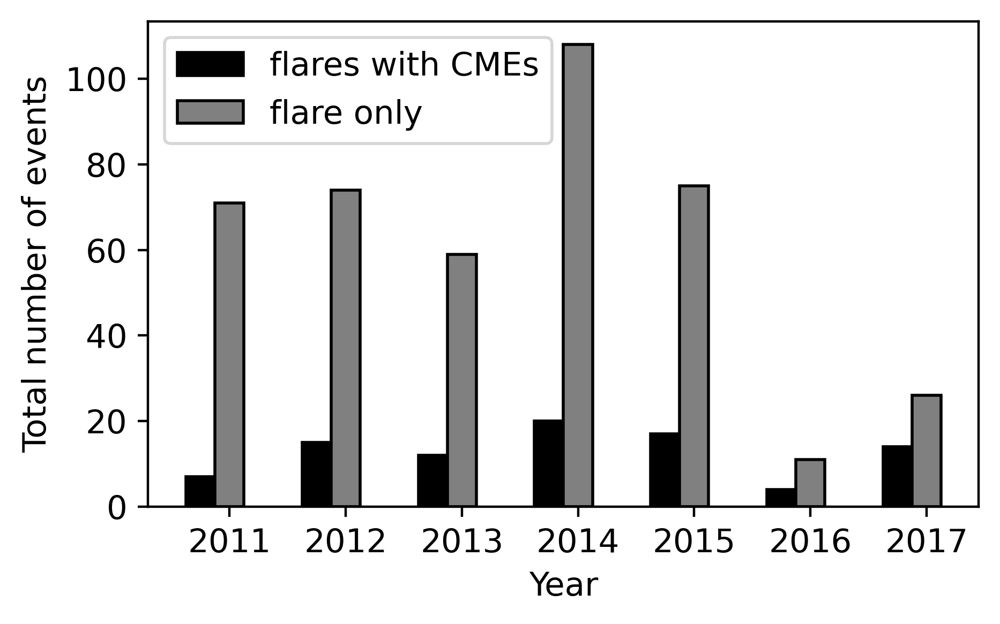

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
barWidth = 0.25
width=np.arange(0,len(year))
width1=[x + barWidth for x in width]
plt.figure(figsize=(5,3),dpi=200)
plt.bar(width, flares_cmes, color ='black', width = 0.25, edgecolor ='black', label ='flares with CMEs')
plt.bar(width1, flare_only, color ='gray', width = 0.25, edgecolor ='black', label ='flare only')
plt.xticks([r + barWidth for r in range(len(year))],
        ['2011','2012','2013','2014','2015','2016','2017'],fontsize=11)
plt.yticks(fontsize=11)
plt.ylabel("Total number of events",fontsize=11)
plt.xlabel("Year",fontsize=11)
plt.legend(loc='best',fontsize=11)

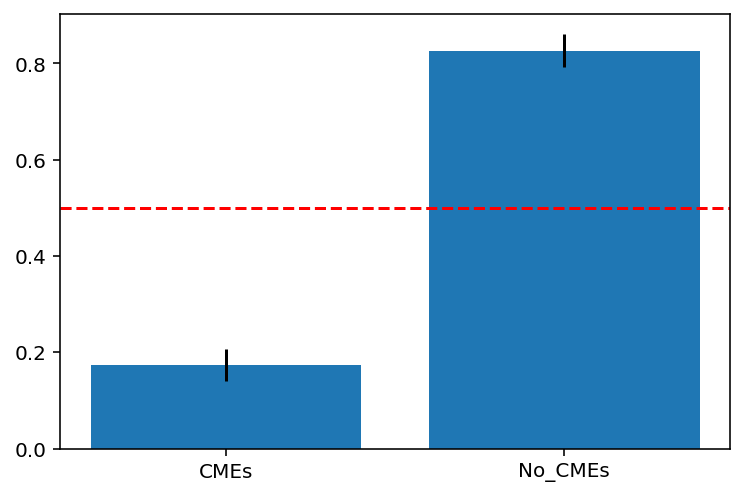

In [ ]:
plt.bar(values,frequency,yerr=errors[0]*1.96)
plt.axhline(expected_frequency,color='red',linestyle='--')

## Adding Temporal information

In [ ]:
def common_rows_Peaktime(positive_class_base,positive_class_n):
  temp_df = pd.DataFrame()
  for i in (positive_class_base.iloc[:,23]):
    data=pd.DataFrame(positive_class_n[(positive_class_n.iloc[:,23] == i)])
    temp_df = temp_df.append(data, ignore_index=True)
  return temp_df

In [ ]:
##new
temp_df_p_36=common_rows_Peaktime(positive_class_48,positive_class_36)
temp_df_p_24=common_rows_Peaktime(positive_class_36,positive_class_24)
temp_df_p_12=common_rows_Peaktime(positive_class_24,positive_class_12)
temp_df_p_8=common_rows_Peaktime(positive_class_12,positive_class_8)



print(temp_df_p_8.shape,temp_df_p_12.shape,temp_df_p_24.shape,temp_df_p_36.shape)

<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)


(73, 24) (73, 24) (75, 24) (75, 24)


<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)


In [ ]:
##taking positive_class_8 as base and filtering out all common rows
temp_df_p1_48=common_rows_Peaktime(temp_df_p_36,positive_class_48)
temp_df_p1_24=common_rows_Peaktime(temp_df_p_24,positive_class_36)
temp_df_p1_36=common_rows_Peaktime(temp_df_p_12,positive_class_24)
temp_df_p1_12=common_rows_Peaktime(temp_df_p_8,positive_class_12)
print(temp_df_p1_48.shape,temp_df_p1_24.shape,temp_df_p1_36.shape,temp_df_p1_12.shape)

<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)


(75, 24) (75, 24) (73, 24) (73, 24)


In [ ]:
temp_df_p_36=common_rows_Peaktime(positive_class_48,positive_class_36)
temp_df_p_24=common_rows_Peaktime(temp_df_p_36,positive_class_24)
temp_df_p_12=common_rows_Peaktime(temp_df_p_24,positive_class_12)
temp_df_p_8=common_rows_Peaktime(temp_df_p_12,positive_class_8)



print(temp_df_p_8.shape,temp_df_p_12.shape,temp_df_p_24.shape,temp_df_p_36.shape)

<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)


(53, 24) (62, 24) (67, 24) (75, 24)


<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)


###filtering all

In [ ]:
##taking positive_class_8 as base and filtering out all common rows
temp_df_p1_48=common_rows_Peaktime(temp_df_p_8,positive_class_48)
temp_df_p1_12=common_rows_Peaktime(temp_df_p_8,temp_df_p_12)
temp_df_p1_24=common_rows_Peaktime(temp_df_p_8,temp_df_p_24)
temp_df_p1_36=common_rows_Peaktime(temp_df_p_8,temp_df_p_36)
print(temp_df_p1_48.shape,temp_df_p1_12.shape,temp_df_p1_24.shape,temp_df_p1_36.shape)

<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)


(53, 24) (53, 24) (53, 24) (53, 24)


In [ ]:
#negative_class

temp_df_n_36=common_rows_Peaktime(negative_class_48,negative_class_36)
temp_df_n_24=common_rows_Peaktime(temp_df_n_36,negative_class_24)
temp_df_n_12=common_rows_Peaktime(temp_df_n_24,negative_class_12)
temp_df_n_8=common_rows_Peaktime(temp_df_n_12,negative_class_8)



print(temp_df_n_8.shape,temp_df_n_12.shape,temp_df_n_24.shape,temp_df_n_36.shape)

<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)


(288, 24) (321, 24) (346, 24) (369, 24)


In [ ]:
positive_class_36.shape

(85, 24)

In [ ]:
#temp_df_n_8=common_rows(negative_class_48,negative_class_8)
temp_df_n1_12=common_rows_Peaktime(temp_df_n_8,temp_df_n_12)
temp_df_n1_24=common_rows_Peaktime(temp_df_n_8,temp_df_n_24)
temp_df_n1_36=common_rows_Peaktime(temp_df_n_8,temp_df_n_36)
temp_df_n1_48=common_rows_Peaktime(temp_df_n_8,negative_class_48)
print(temp_df_n1_48.shape,temp_df_n1_12.shape,temp_df_n1_24.shape,temp_df_n1_36.shape)

<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)
<ipython-input-26-c29d6a70c709>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(data, ignore_index=True)


(288, 24) (288, 24) (288, 24) (288, 24)


###difference

In [ ]:
##difference plot
def diff(second_ts,first_ts):
  diff_ts=np.array(second_ts.iloc[:,5:23])-np.array(first_ts.iloc[:,5:23])
  return diff_ts



In [ ]:
temp_df_p_8.shape

(53, 24)

In [ ]:
#positive_class_12_n=#
diff_p_8_12=diff(temp_df_p1_12,temp_df_p_8)
diff_p_12_24=diff(temp_df_p1_24,temp_df_p1_12)
diff_p_24_36=diff(temp_df_p1_36,temp_df_p1_24)
diff_p_36_48=diff(temp_df_p1_48,temp_df_p1_36)

In [ ]:
#negative_class_12_n=#
diff_n_8_12=diff(temp_df_n1_12,temp_df_n_8)
diff_n_12_24=diff(temp_df_n1_24,temp_df_n1_12)
diff_n_24_36=diff(temp_df_n1_36,temp_df_n1_24)
diff_n_36_48=diff(temp_df_n1_48,temp_df_n1_36)


In [ ]:
temp_df_n1_24.shape

(288, 24)

In [ ]:
data_p8_new=pd.concat([pd.DataFrame(np.array(temp_df_p_8)[:,5:23]),pd.DataFrame(np.array(diff_p_8_12))],axis=1,ignore_index=True)
data_n8_new=pd.concat([pd.DataFrame(np.array(temp_df_n_8)[:,5:23]),pd.DataFrame(np.array(diff_n_8_12))],axis=1,ignore_index=True)
##12-24hour
data_p12_new=pd.concat([pd.DataFrame(np.array(temp_df_p1_12)[:,5:23]),pd.DataFrame(np.array(diff_p_12_24))],axis=1,ignore_index=True)
data_n12_new=pd.concat([pd.DataFrame(np.array(temp_df_n1_12)[:,5:23]),pd.DataFrame(np.array(diff_n_12_24))],axis=1,ignore_index=True)
##24-36hour
data_p24_new=pd.concat([pd.DataFrame(np.array(temp_df_p1_24)[:,5:23]),pd.DataFrame(np.array(diff_p_24_36))],axis=1,ignore_index=True)
data_n24_new=pd.concat([pd.DataFrame(np.array(temp_df_n1_24)[:,5:23]),pd.DataFrame(np.array(diff_n_24_36))],axis=1,ignore_index=True)
##36-48hour
data_p36_new=pd.concat([pd.DataFrame(np.array(temp_df_p1_36)[:,5:23]),pd.DataFrame(np.array(diff_p_36_48))],axis=1,ignore_index=True)
data_n36_new=pd.concat([pd.DataFrame(np.array(temp_df_n1_36)[:,5:23]),pd.DataFrame(np.array(diff_n_36_48))],axis=1,ignore_index=True)

In [ ]:
col=['USFLUX', 'MEANGBT',
       'MEANJZH', 'MEANPOT', 'SHRGT45', 'TOTUSJH', 'MEANGBH', 'MEANALP',
       'MEANGAM', 'MEANGBZ', 'MEANJZD', 'TOTUSJZ', 'SAVNCPP', 'TOTPOT',
       'MEANSHR', 'AREA_ACR', 'R_VALUE', 'ABSNJZH']

In [ ]:
col1=['USFLUX,', 'MEANGBT,',
       'MEANJZH,', 'MEANPOT,', 'SHRGT45,', 'TOTUSJH,', 'MEANGBH,', 'MEANALP,',
       'MEANGAM,', 'MEANGBZ,', 'MEANJZD,', 'TOTUSJZ,', 'SAVNCPP,', 'TOTPOT,',
       'MEANSHR,', 'AREA_ACR,', 'R_VALUE,', 'ABSNJZH','diff_USFLUX,', 'diff_MEANGBT,',
       'diff_MEANJZH,', 'diff_MEANPOT,', 'diff_SHRGT45,', 'diff_TOTUSJH,', 'diff_MEANGBH,', 'diff_MEANALP,',
       'diff_MEANGAM,', 'diff_MEANGBZ,', 'diff_MEANJZD,', 'diff_TOTUSJZ,', 'diff_SAVNCPP,', 'diff_TOTPOT,',
       'diff_MEANSHR,', 'diff_AREA_ACR,', 'diff_R_VALUE,', 'diff_ABSNJZH']

###saving to csv file

In [ ]:
data_p8_new.to_csv("/content/drive/MyDrive/flare_cmes_change/data_p8_new.csv")
data_n8_new.to_csv("/content/drive/MyDrive/flare_cmes_change/data_n8_new.csv")
data_p12_new.to_csv("/content/drive/MyDrive/flare_cmes_change/data_p12_new.csv")
data_n12_new.to_csv("/content/drive/MyDrive/flare_cmes_change/data_n12_new.csv")
data_p24_new.to_csv("/content/drive/MyDrive/flare_cmes_change/data_p24_new.csv")
data_n24_new.to_csv("/content/drive/MyDrive/flare_cmes_change/data_n24_new.csv")
data_p36_new.to_csv("/content/drive/MyDrive/flare_cmes_change/data_p36_new.csv")
data_n36_new.to_csv("/content/drive/MyDrive/flare_cmes_change/data_n36_new.csv")

## Histogram (declare col1, colO)

In [ ]:
col=['USFLUX', 'MEANGBT',
       'MEANJZH', 'MEANPOT', 'SHRGT45', 'TOTUSJH', 'MEANGBH', 'MEANALP',
       'MEANGAM', 'MEANGBZ', 'MEANJZD', 'TOTUSJZ', 'SAVNCPP', 'TOTPOT',
       'MEANSHR', 'AREA_ACR', 'R_VALUE', 'ABSNJZH']

In [ ]:
col1=['USFLUX,', 'MEANGBT,',
       'MEANJZH,', 'MEANPOT,', 'SHRGT45,', 'TOTUSJH,', 'MEANGBH,', 'MEANALP,',
       'MEANGAM,', 'MEANGBZ,', 'MEANJZD,', 'TOTUSJZ,', 'SAVNCPP,', 'TOTPOT,',
       'MEANSHR,', 'AREA_ACR,', 'R_VALUE,', 'ABSNJZH','diff_USFLUX,', 'diff_MEANGBT,',
       'diff_MEANJZH,', 'diff_MEANPOT,', 'diff_SHRGT45,', 'diff_TOTUSJH,', 'diff_MEANGBH,', 'diff_MEANALP,',
       'diff_MEANGAM,', 'diff_MEANGBZ,', 'diff_MEANJZD,', 'diff_TOTUSJZ,', 'diff_SAVNCPP,', 'diff_TOTPOT,',
       'diff_MEANSHR,', 'diff_AREA_ACR,', 'diff_R_VALUE,', 'diff_ABSNJZH']

In [ ]:
##normalize the data


In [ ]:
#CME_data_8,no_CME_data_8,xdata_shuffled,ydata_shuffled=data_gen(positive_class_8,negative_class_8)
#CME_data_12,no_CME_data_12,xdata_shuffled,ydata_shuffled=data_gen(positive_class_12,negative_class_12)
#CME_data_24,no_CME_data_24,xdata_shuffled,ydata_shuffled=data_gen(positive_class_24,negative_class_24)
CME_data_36,no_CME_data_36,xdata_shuffled,ydata_shuffled=data_gen(positive_class_36,negative_class_36)  ##the output is normalized, both cme data, and xdatashuffled
#CME_data_48,no_CME_data_48,xdata_shuffled,ydata_shuffled=data_gen(positive_class_48,negative_class_48)



In [ ]:
import scipy
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.stats import norm
def histogram(CME_data,no_CME_data,i):
  mu=np.mean(CME_data[:,i])
  std=np.std(CME_data[:,i])
  mu1=np.mean(no_CME_data[:,i])
  std1=np.std(no_CME_data[:,i])
  num_bins = 15
  #plt.figure(figsize=(5,5))
  hist_fl, bins_fl=np.histogram(CME_data[:, i], num_bins, density=True)
  y_fl = scipy.stats.norm.pdf(bins_fl, mu, std)
  plt.plot(bins_fl,y_fl, 'g--', linewidth=2, label='flares with cmes')
  histno_fl, binsno_fl=np.histogram(no_CME_data[:, i], num_bins, density=True)
  yno_fl = scipy.stats.norm.pdf(binsno_fl, mu1, std1)
  plt.plot(binsno_fl,yno_fl, 'r--',linewidth=2, label='flares without cmes')
  plt.xticks(fontsize=12)
  plt.yticks(fontsize=12)
  plt.legend(fontsize=12)
  plt.ylabel("Prob Density",fontsize=12)
  plt.title(col[i],fontsize=12)
  plt.show()

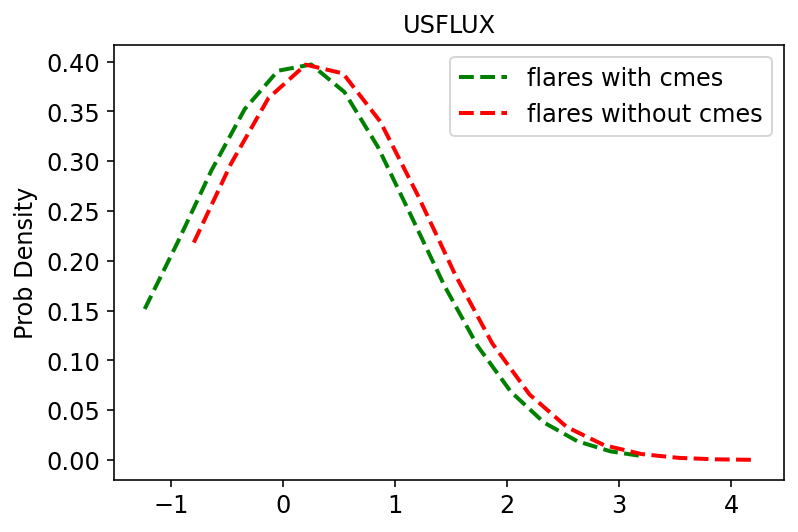

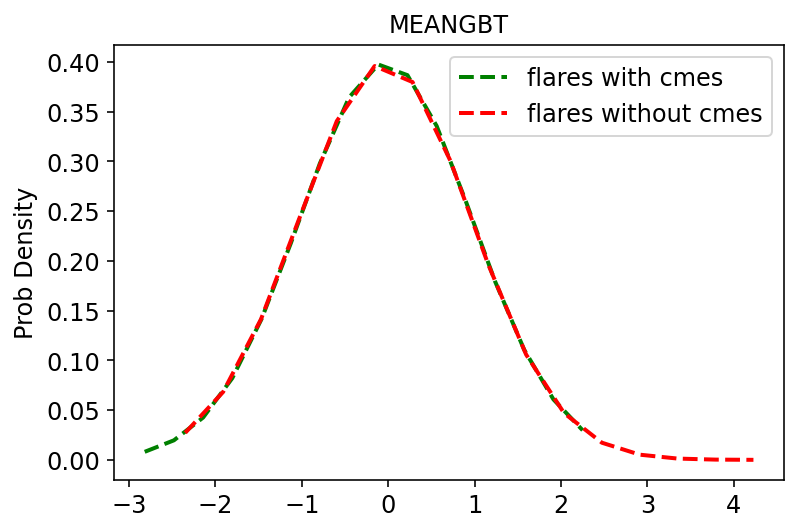

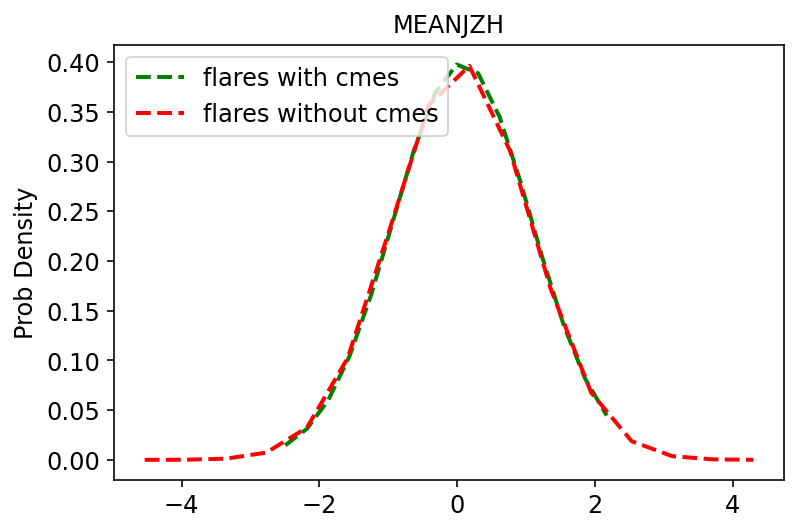

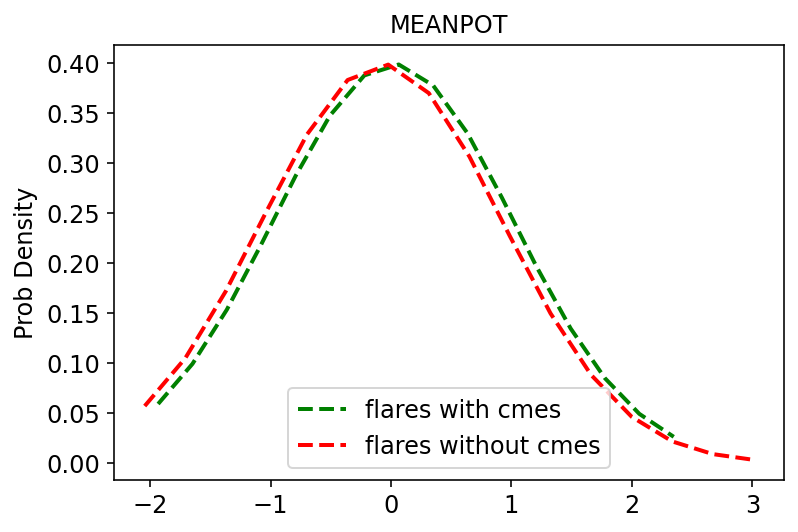

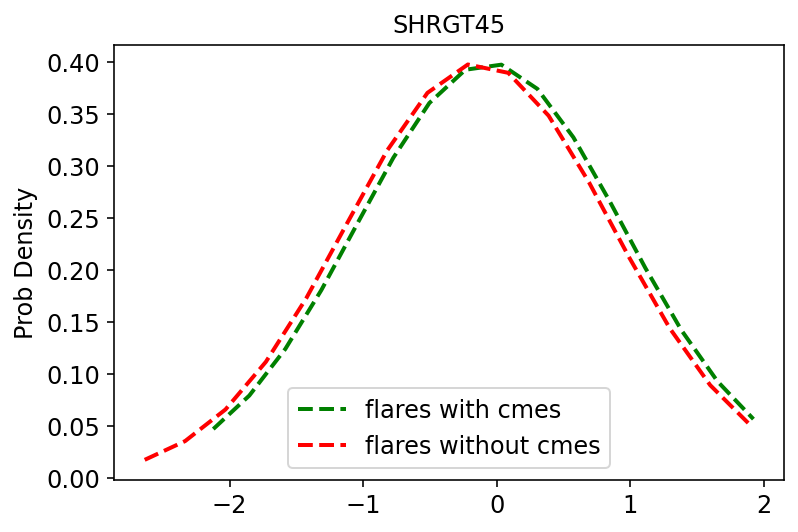

...

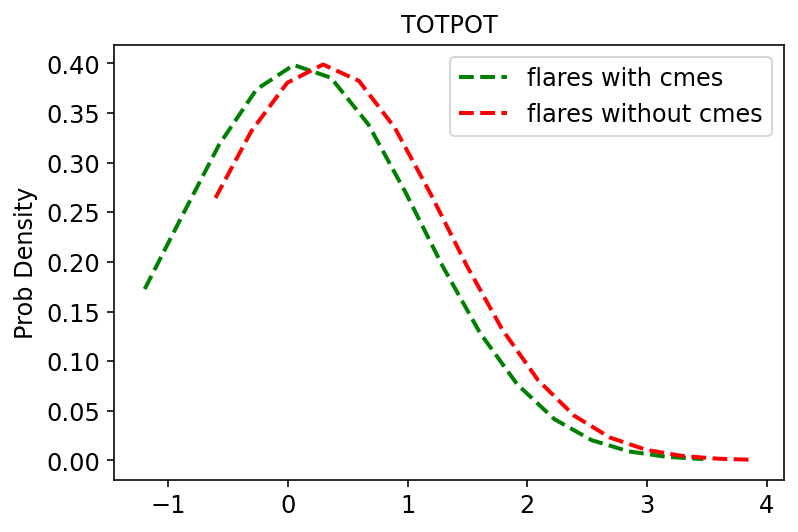

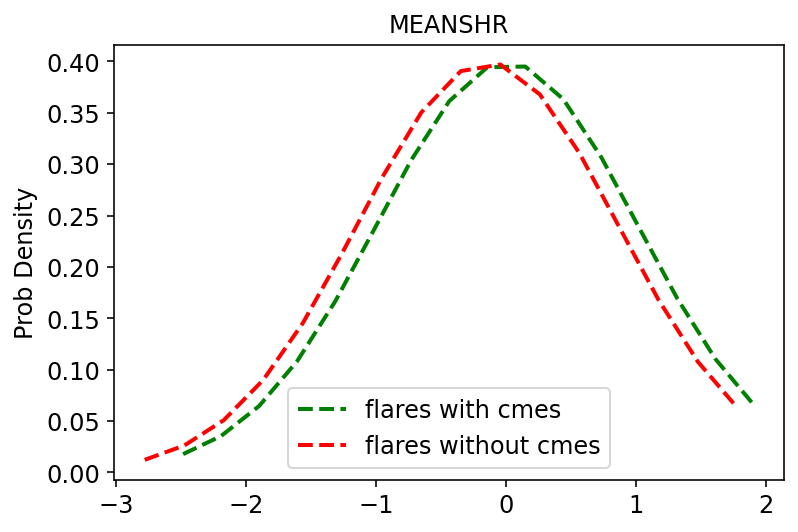

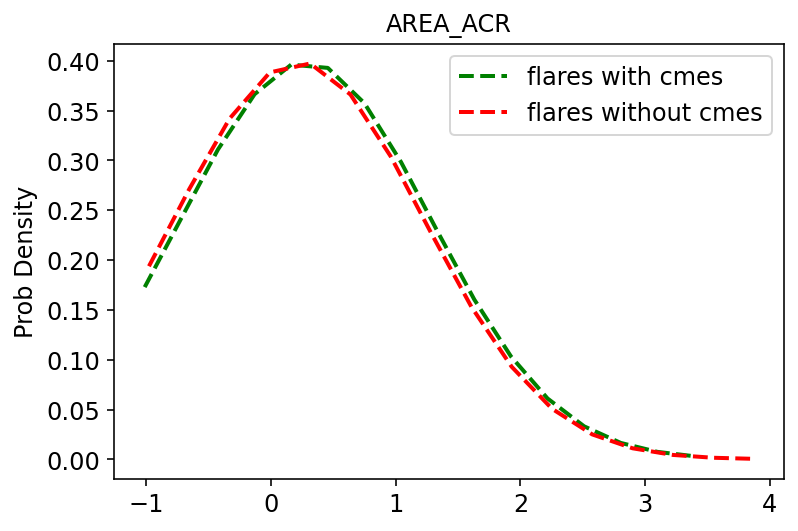

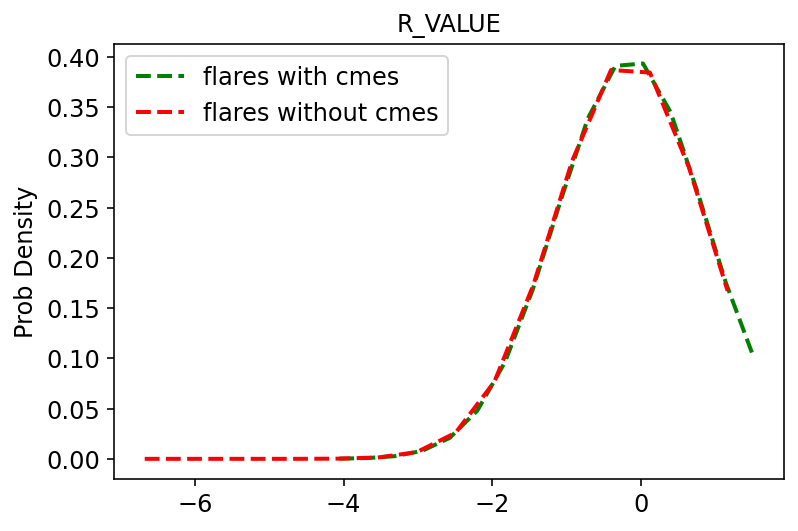

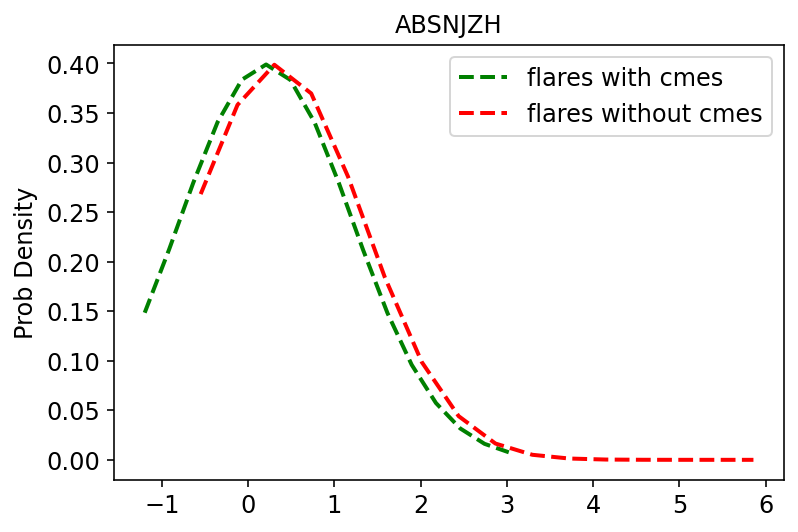

In [ ]:
for i in range(0,18):
    #plt.subplots(1,5,j+1, figsize=(5,5))
    histogram(CME_data_36,no_CME_data_36,i)

In [ ]:
CME_data=[CME_data_8,CME_data_12,CME_data_24,CME_data_36,CME_data_48]
no_CME_data=[no_CME_data_8,no_CME_data_12,no_CME_data_24,no_CME_data_36,no_CME_data_48]

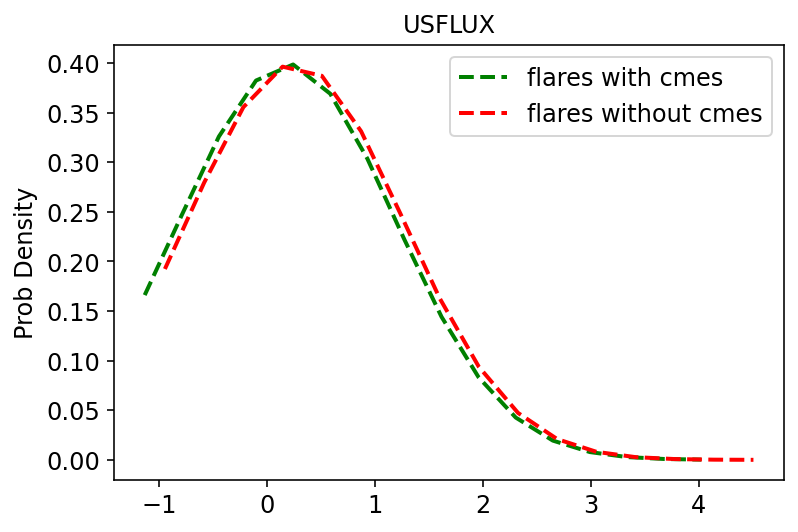

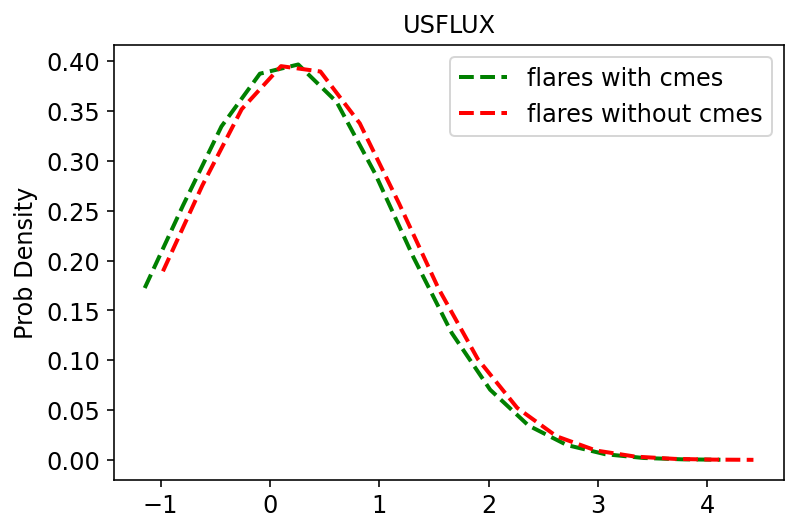

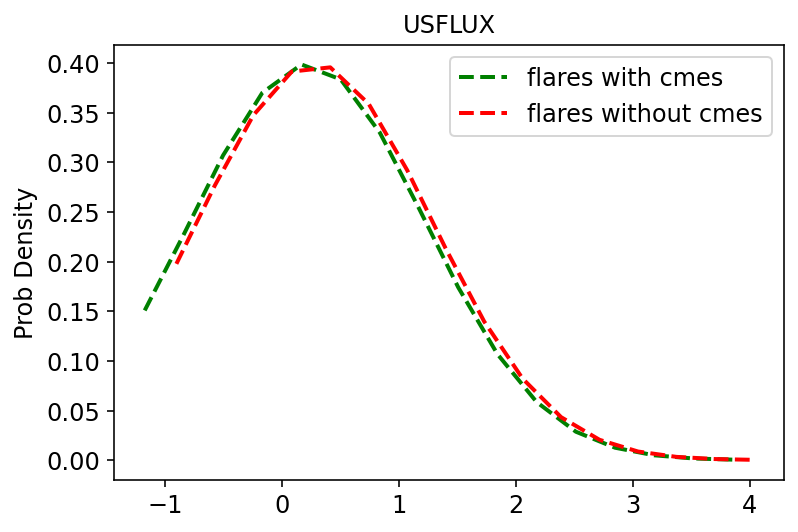

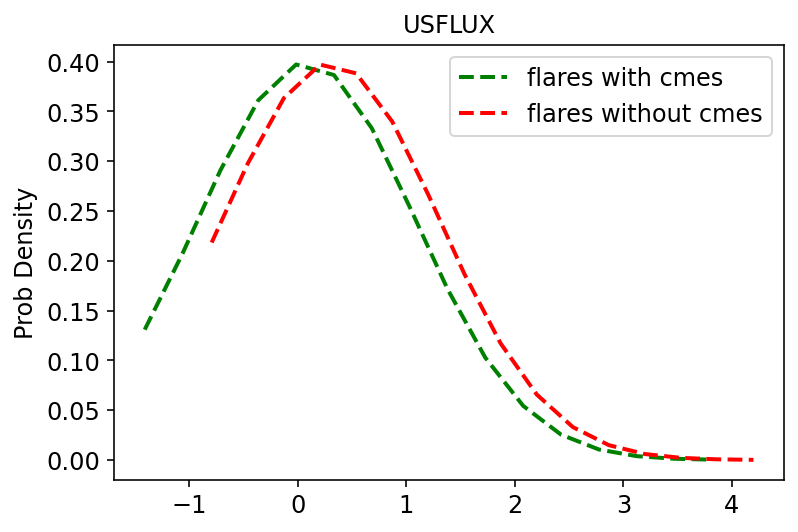

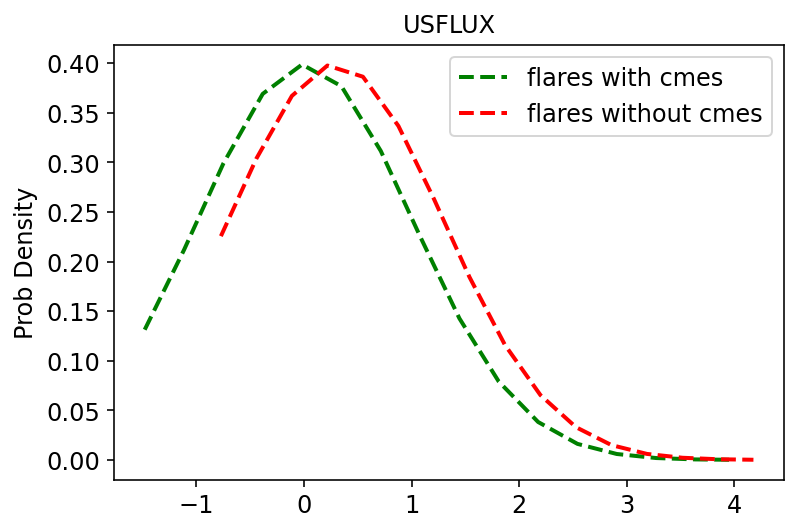

...

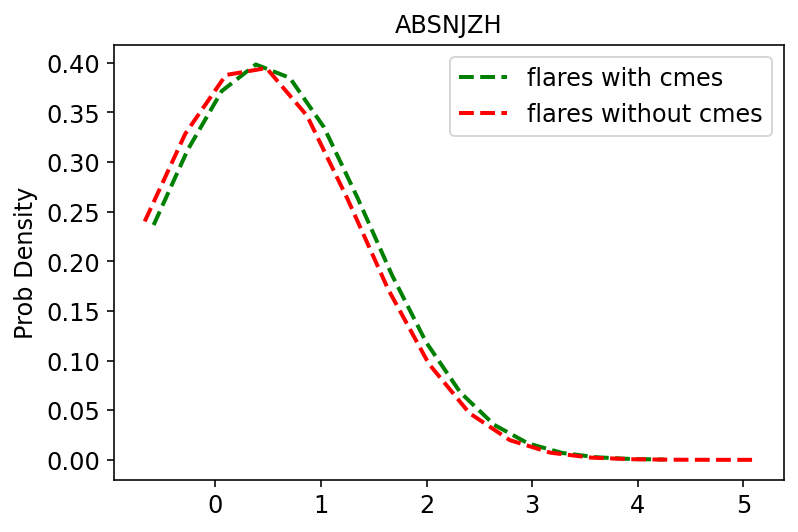

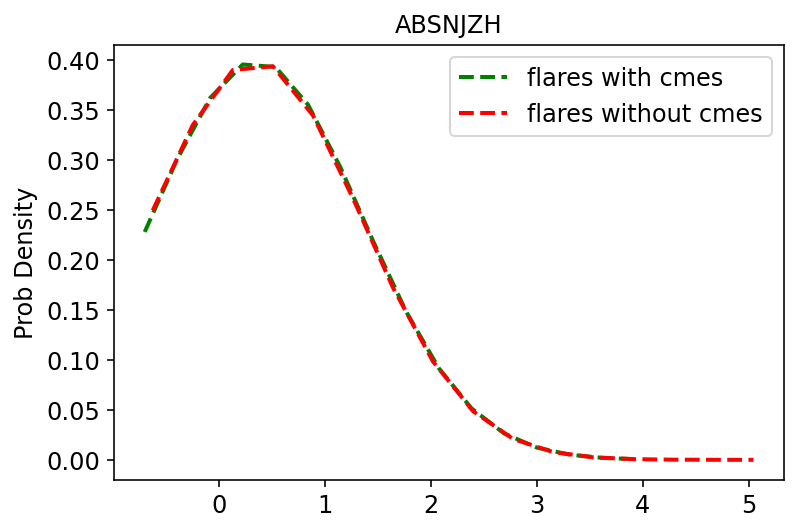

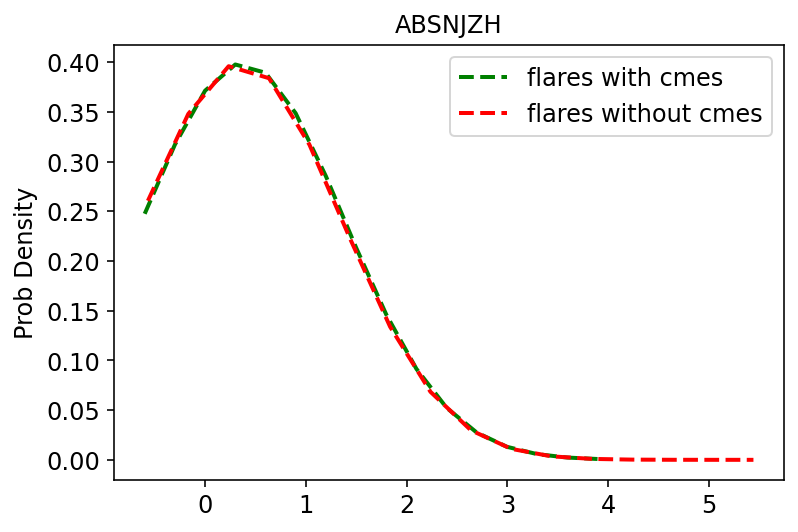

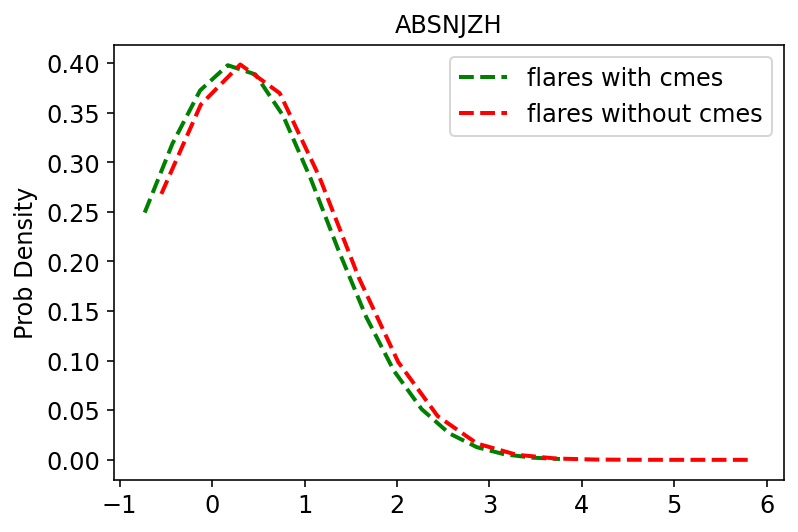

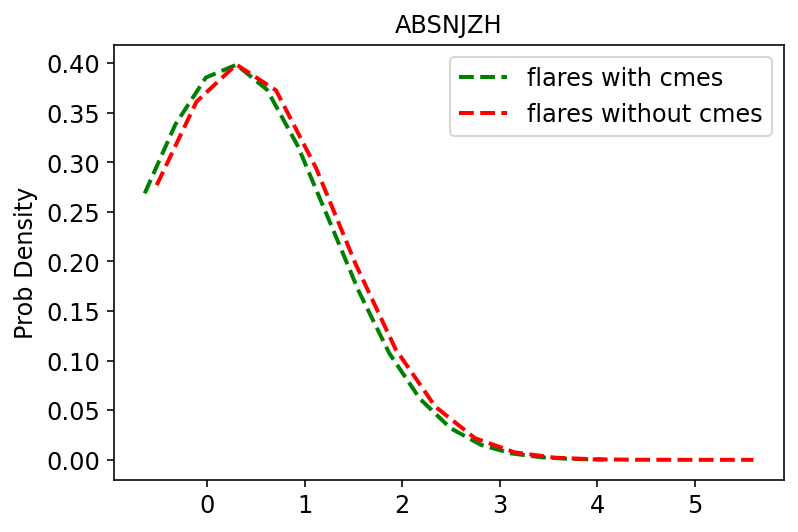

In [ ]:
for i in range(0,18):
  for j in range(0,5):
    #plt.subplots(1,5,j+1, figsize=(5,5))
    CME_data_n=CME_data[j]
    no_CME_data_n=no_CME_data[j]
    histogram(CME_data_n,no_CME_data_n,i)

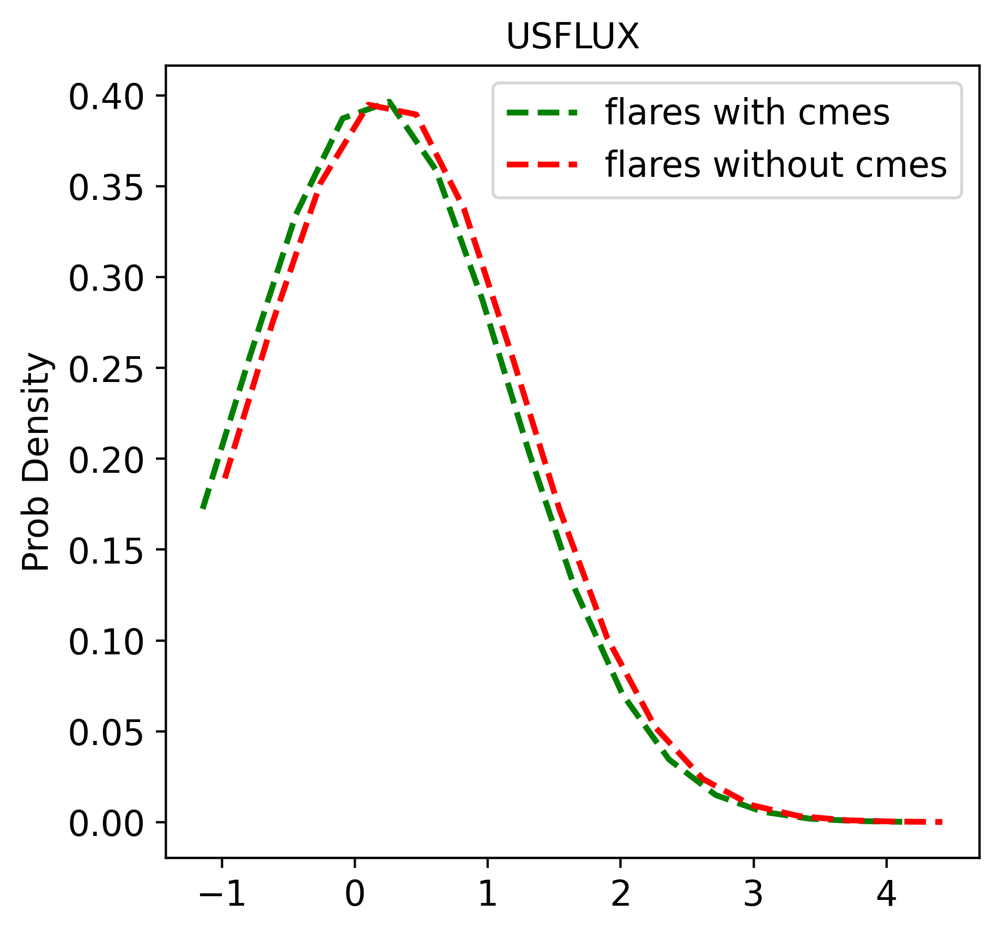

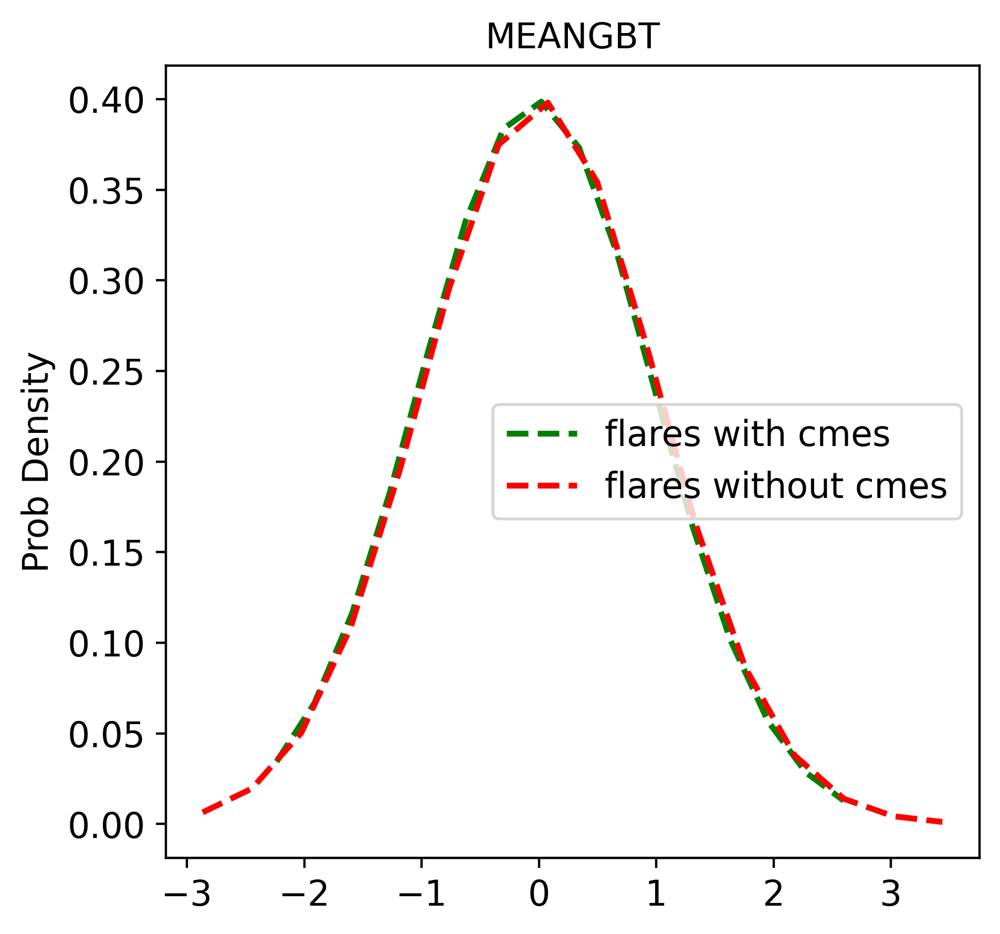

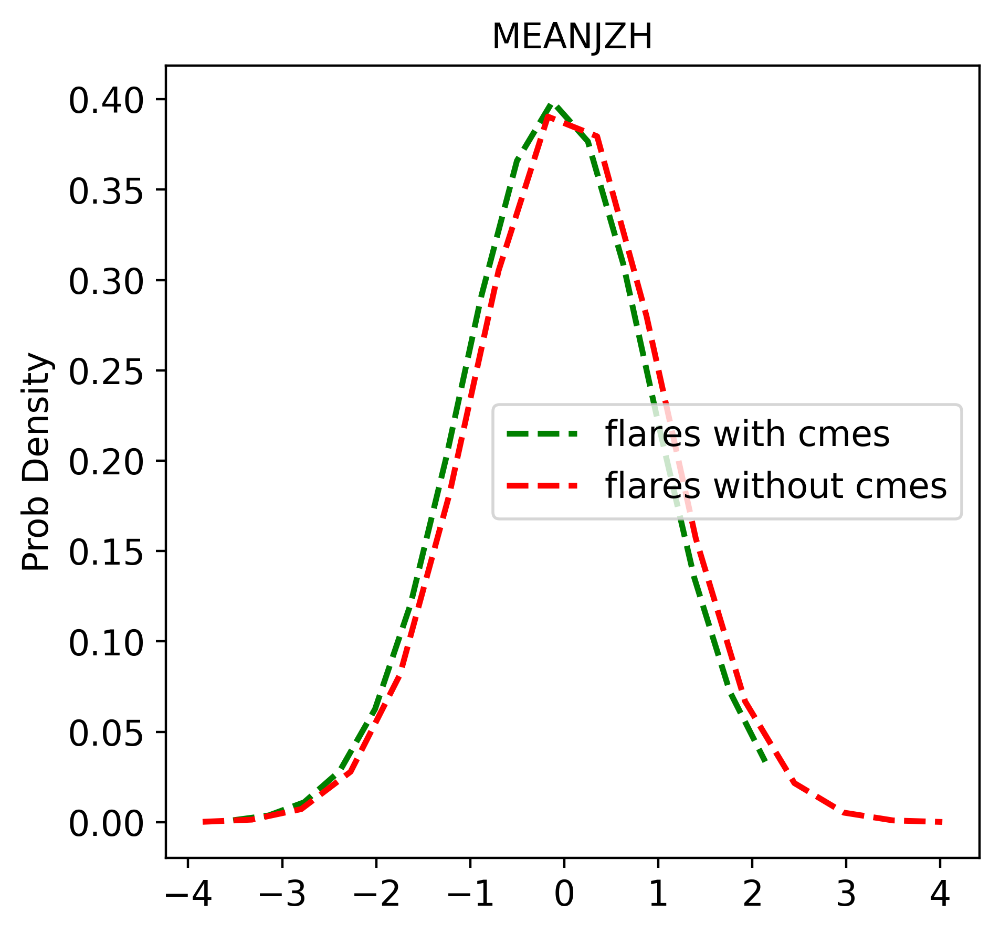

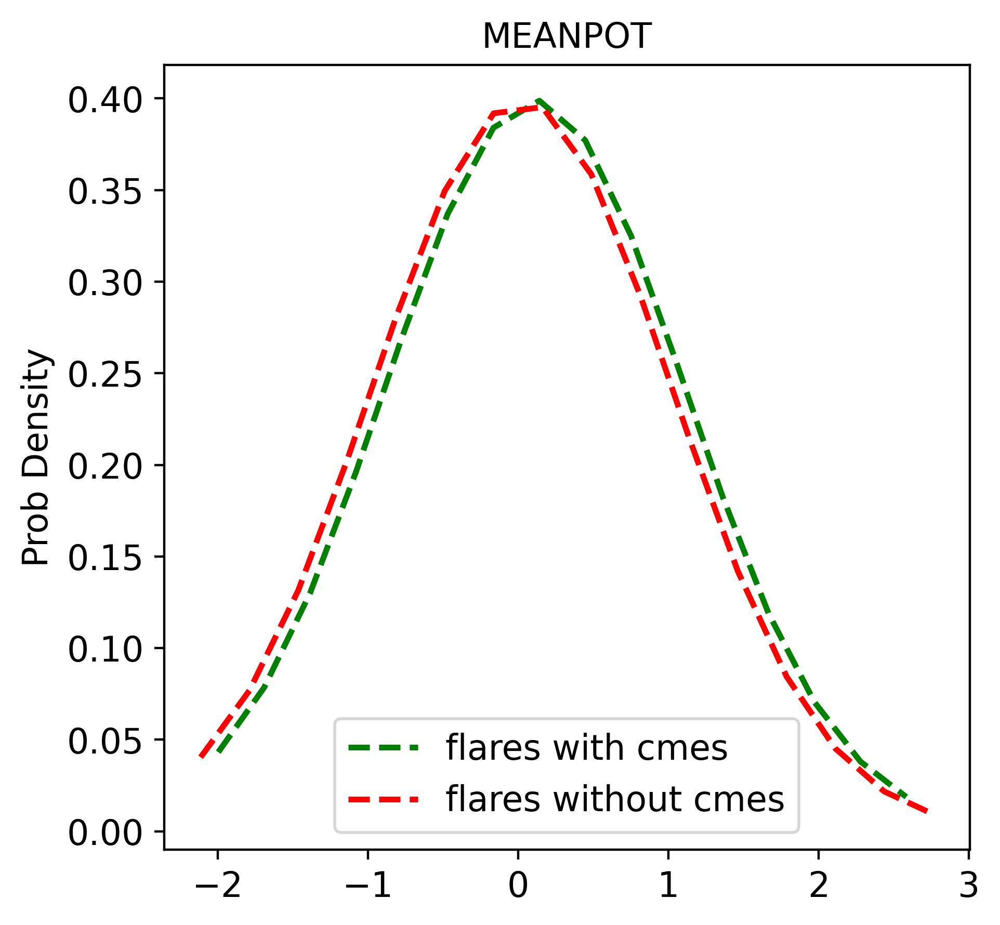

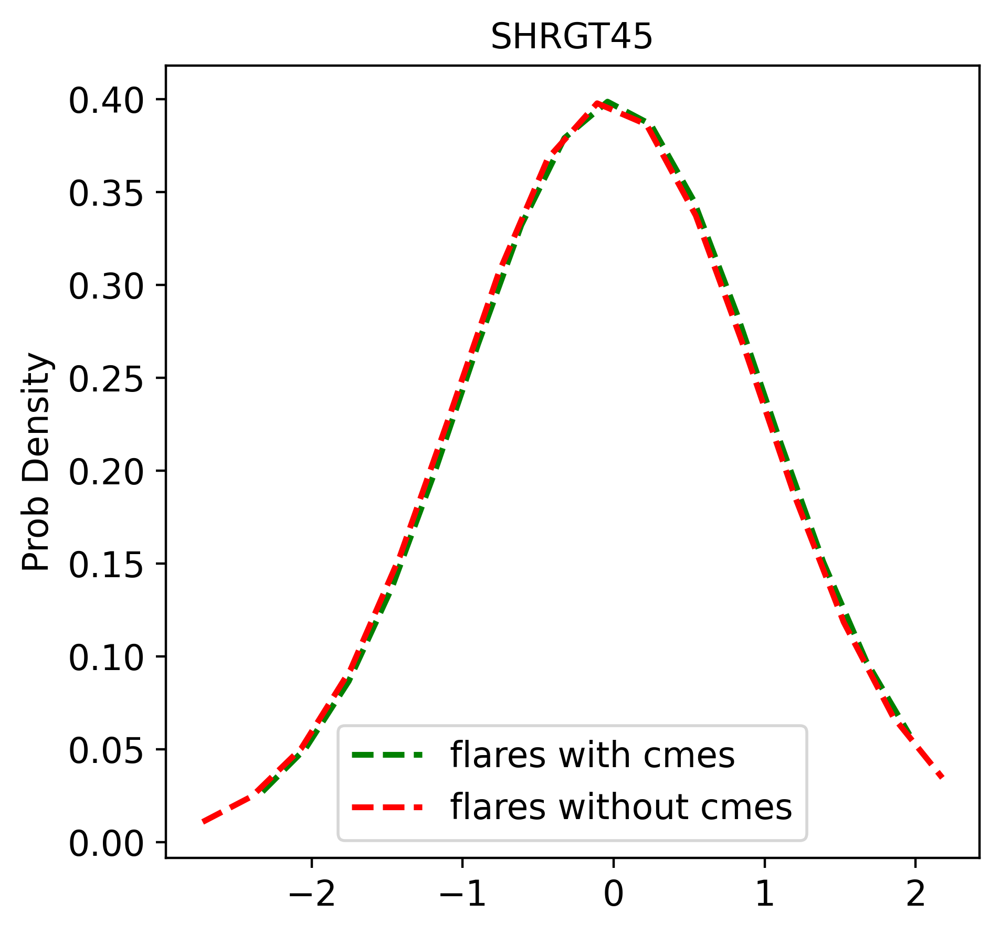

...

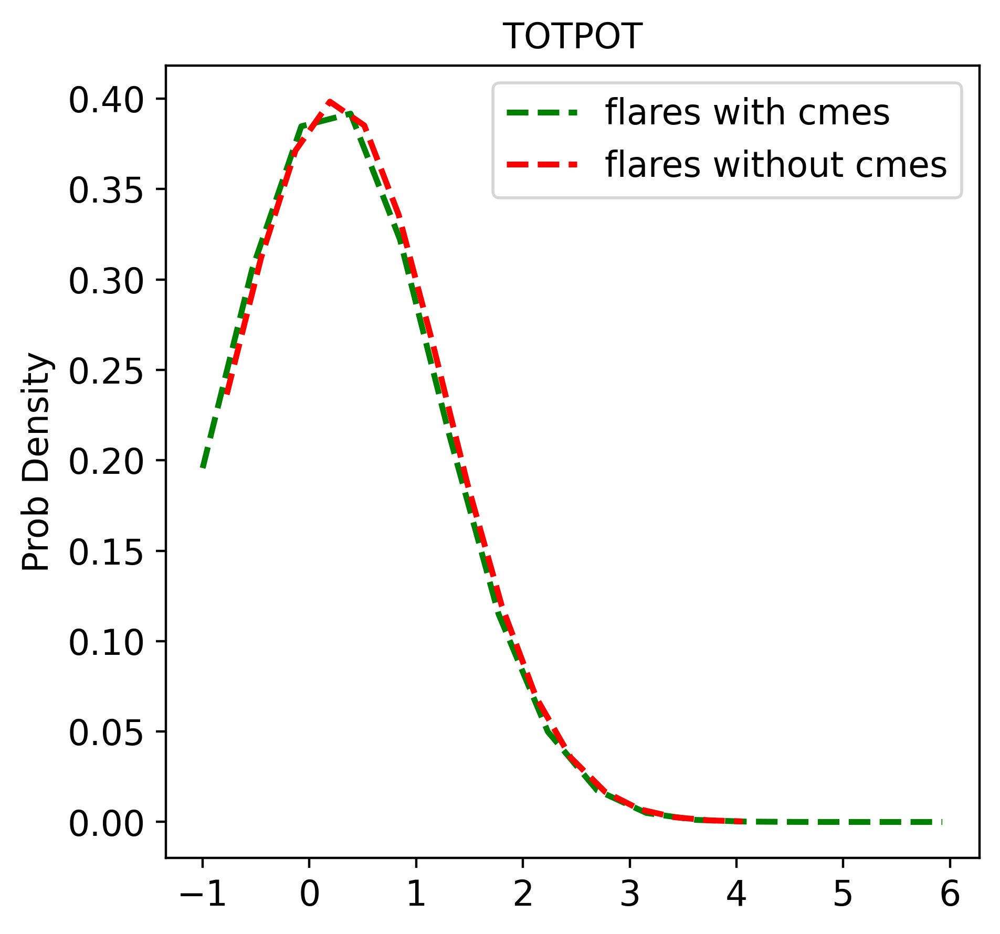

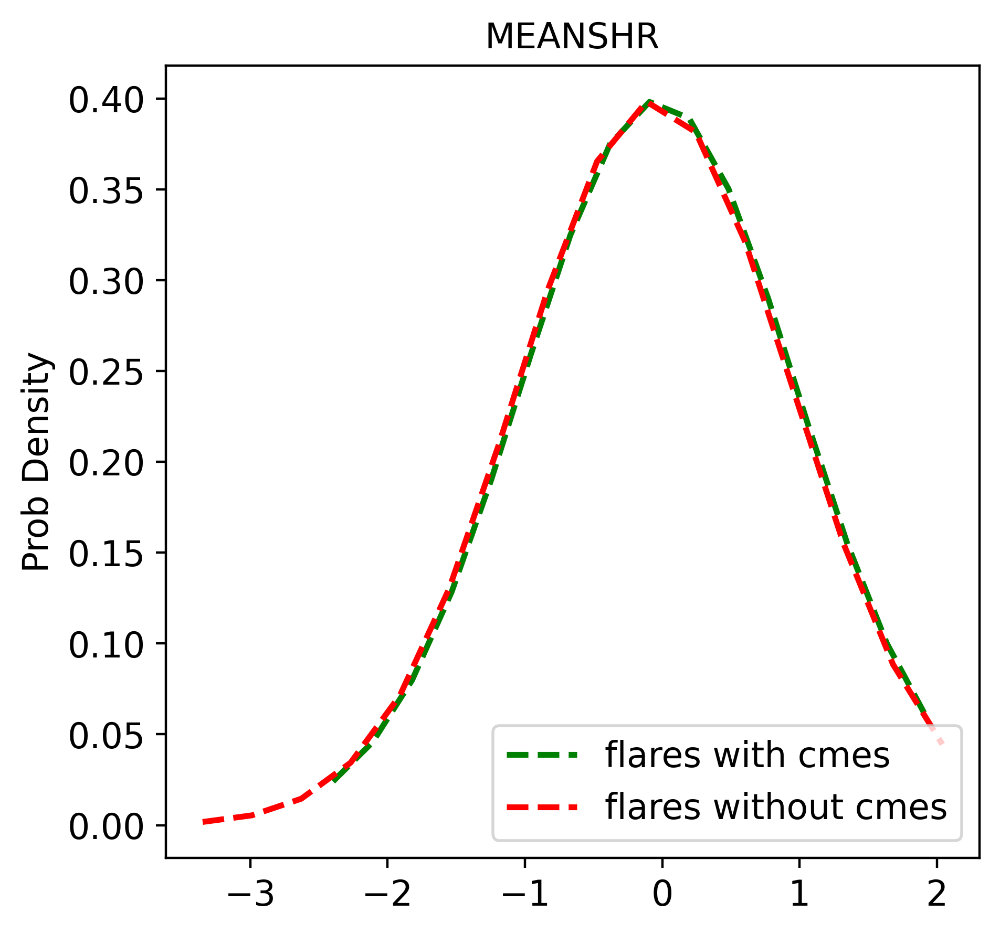

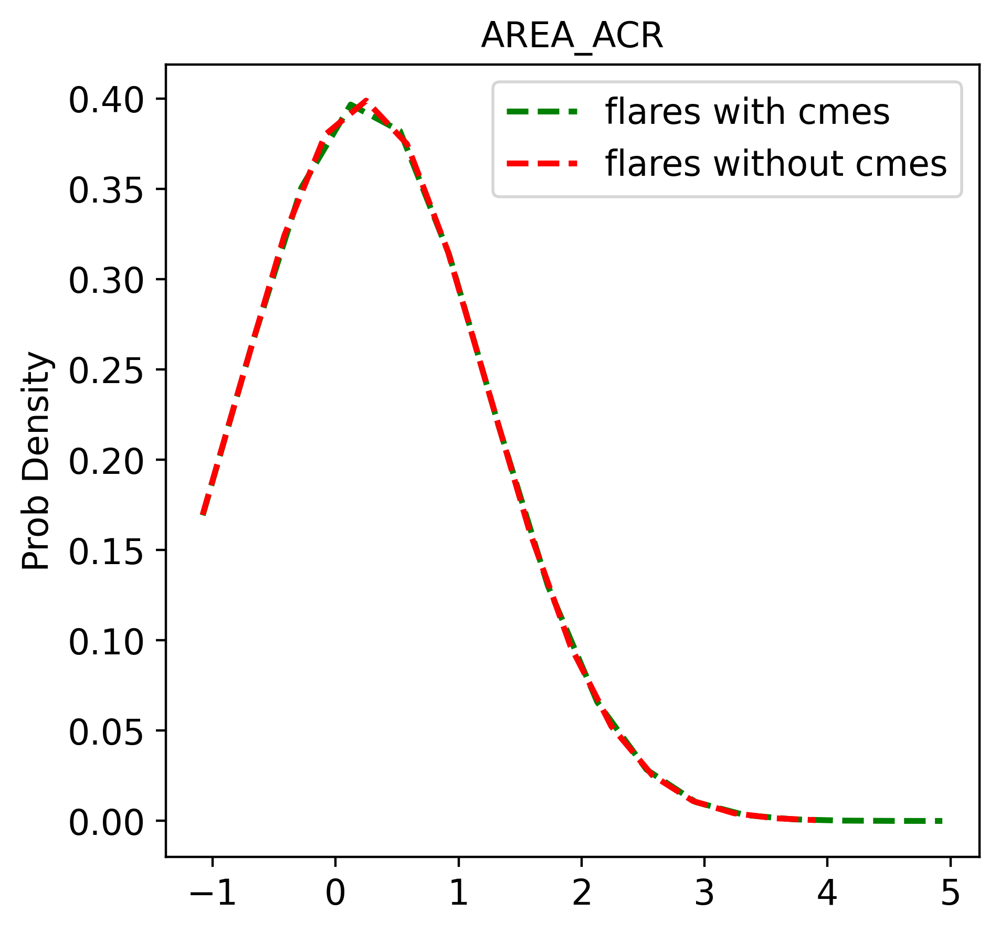

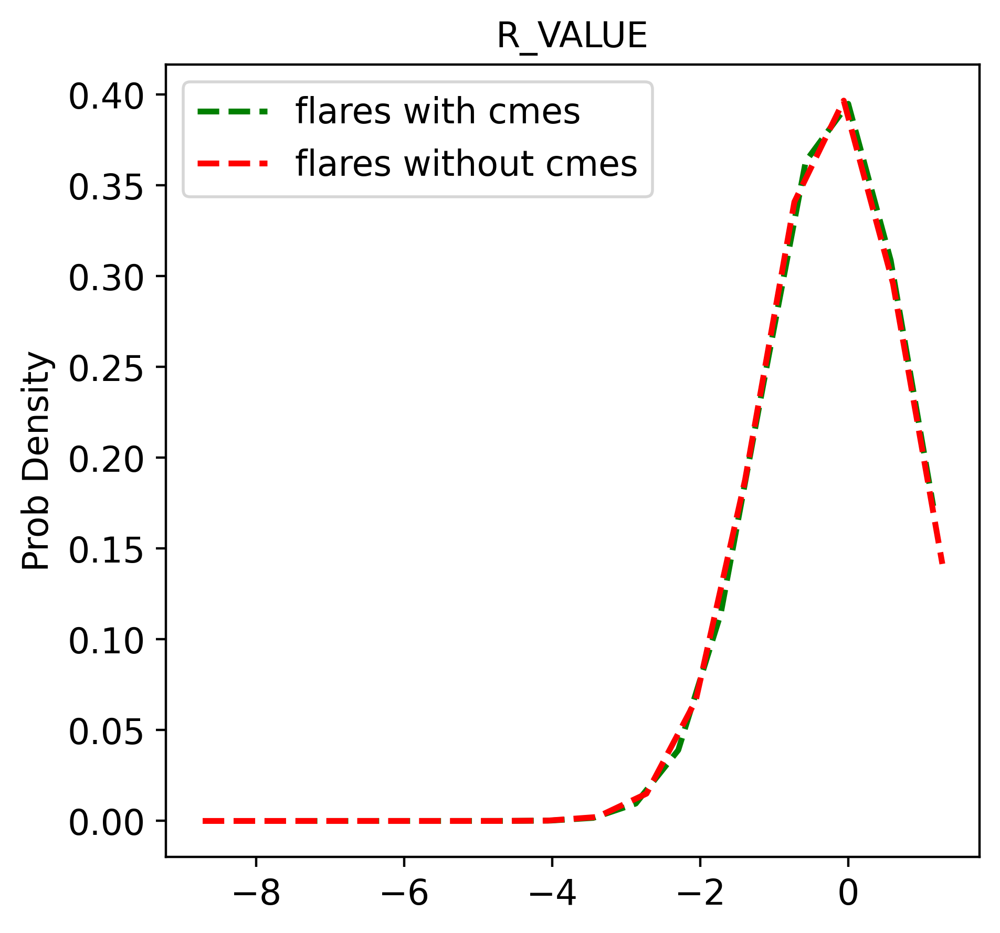

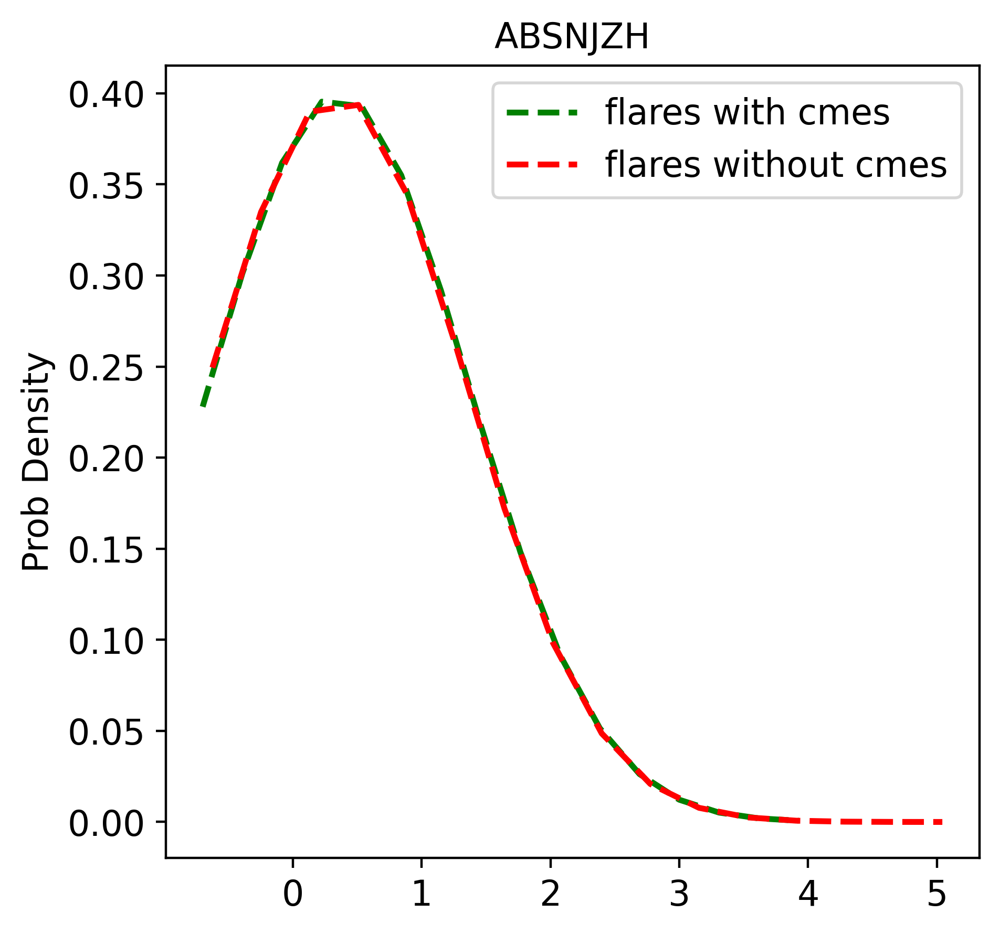

In [ ]:
import scipy
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.stats import norm
CME_data=CME_data_12
no_CME_data=no_CME_data_12
for i in range(0,18):
  mu=np.mean(CME_data[:,i])
  std=np.std(CME_data[:,i])
  mu1=np.mean(no_CME_data[:,i])
  std1=np.std(no_CME_data[:,i])
  num_bins = 15
  plt.figure(figsize=(5,5),dpi=200)
  hist_fl, bins_fl=np.histogram(CME_data[:, i], num_bins, density=True)
  y_fl = scipy.stats.norm.pdf(bins_fl, mu, std)
  plt.plot(bins_fl,y_fl, 'g--', linewidth=2, label='flares with cmes')
  histno_fl, binsno_fl=np.histogram(no_CME_data[:, i], num_bins, density=True)
  yno_fl = scipy.stats.norm.pdf(binsno_fl, mu1, std1)
  plt.plot(binsno_fl,yno_fl, 'r--',linewidth=2, label='flares without cmes')
  plt.xticks(fontsize=12)
  plt.yticks(fontsize=12)
  plt.legend(fontsize=12)
  plt.ylabel("Prob Density",fontsize=12)
  plt.title(col[i],fontsize=12)
  plt.show()

## DATA Processing

Normalizing the data

In [ ]:
def normalize_the_data(flare_data):
    flare_data = np.array(flare_data)
    n_elements = flare_data.shape[0]
    for j in range(flare_data.shape[1]):
        standard_deviation_of_this_feature = np.std(flare_data[:,j])
        median_of_this_feature = np.median(flare_data[:,j])
        for i in range(n_elements):
            flare_data[i,j] = (flare_data[i,j] - median_of_this_feature) / (standard_deviation_of_this_feature)
    return flare_data



##Data processing for positive and negative class

In [ ]:
import pandas as pd
def data_gen(positive_cl,negative_cl):
  CME_data=positive_cl.iloc[:,5:23]
  no_CME_data=negative_cl.iloc[:,5:23]
  import numpy as np
  def normalize_the_data(flare_data):
      flare_data = np.array(flare_data)
      n_elements = flare_data.shape[0]
      for j in range(flare_data.shape[1]):
          standard_deviation_of_this_feature = np.std(flare_data[:, j])
          median_of_this_feature = np.median(flare_data[:, j])
          for i in range(n_elements):
              flare_data[i, j] = (
                  flare_data[i, j] - median_of_this_feature) / (standard_deviation_of_this_feature)
      return flare_data


  no_CME_data = normalize_the_data(no_CME_data)
  CME_data = normalize_the_data(CME_data)

  #print("There are", no_CME_data.shape[0], "flares with no associated CMEs.")
  #print("There are", CME_data.shape[0], "flares with associated CMEs.")
  # select the number of features
  N_features = 18
  Nfl = CME_data.shape[0]
  Nnofl = no_CME_data.shape[0]
  yfl = np.ones(Nfl)
  ynofl = np.zeros(Nnofl)
  number_of_examples = Nfl + Nnofl

  #svm1 = svm.SVC(C=C, gamma=gamma, kernel='rbf', class_weight=class_weight,
  #           cache_size=500, max_iter=-1, shrinking=True, tol=1e-8, probability=True)
  xdata = np.concatenate((CME_data, no_CME_data), axis=0)
  ydata = np.concatenate((np.ones(Nfl), np.zeros(Nnofl)), axis=0)
  shuffle_index = np.arange(len(ydata))                  # shuffle the data indices
  np.random.shuffle(shuffle_index)
  ydata_shuffled = ydata[shuffle_index]
  xdata_shuffled = xdata[shuffle_index,:]
  speed_index=xdata
  return CME_data,no_CME_data,xdata_shuffled,ydata_shuffled

In [ ]:
def data_gen_change(positive_cl,negative_cl):
  CME_data=positive_cl
  no_CME_data=negative_cl
  import numpy as np
  def normalize_the_data(flare_data):
      flare_data = np.array(flare_data)
      n_elements = flare_data.shape[0]
      for j in range(flare_data.shape[1]):
          standard_deviation_of_this_feature = np.std(flare_data[:, j])
          median_of_this_feature = np.median(flare_data[:, j])
          for i in range(n_elements):
              flare_data[i, j] = (
                  flare_data[i, j] - median_of_this_feature) / (standard_deviation_of_this_feature)
      return flare_data


  no_CME_data = normalize_the_data(no_CME_data)
  CME_data = normalize_the_data(CME_data)

  #print("There are", no_CME_data.shape[0], "flares with no associated CMEs.")
  #print("There are", CME_data.shape[0], "flares with associated CMEs.")
  # select the number of features
  N_features = 36
  Nfl = CME_data.shape[0]
  Nnofl = no_CME_data.shape[0]
  yfl = np.ones(Nfl)
  ynofl = np.zeros(Nnofl)
  number_of_examples = Nfl + Nnofl
  #svm1 = svm.SVC(C=C, gamma=gamma, kernel='rbf', class_weight=class_weight,
  #           cache_size=500, max_iter=-1, shrinking=True, tol=1e-8, probability=True)
  xdata = np.concatenate((CME_data, no_CME_data), axis=0)
  ydata = np.concatenate((np.ones(Nfl), np.zeros(Nnofl)), axis=0)
  shuffle_index = np.arange(len(ydata))                  # shuffle the data indices
  np.random.shuffle(shuffle_index)
  ydata_shuffled = ydata[shuffle_index]
  xdata_shuffled = xdata[shuffle_index,:]
  return CME_data,no_CME_data,xdata_shuffled,ydata_shuffled

##Feature selection kbest

In [ ]:
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.feature_selection import chi2, f_regression

def feature_selection(positive_class,negative_class,method):
  if method==1:
    selector = SelectKBest(f_classif, k=18)
    CME_data,no_CME_data,xdata,ydata=data_gen(positive_class,negative_class)
  else:
    selector = SelectKBest(f_classif, k=36)
    CME_data,no_CME_data,xdata,ydata=data_gen_change(positive_class,negative_class)
  selector.fit(xdata, ydata)
  scores = -np.log10(selector.pvalues_)
  scores /= scores.max()
  return xdata,scores

In [ ]:
xdata_8,scores_8=feature_selection (positive_class_8,negative_class_8)
xdata_12,scores_12=feature_selection (positive_class_12,negative_class_12)
xdata_24,scores_24=feature_selection (positive_class_24,negative_class_24)
xdata_36,scores_36=feature_selection (positive_class_36,negative_class_36)
xdata_48,scores_48=feature_selection (positive_class_48,negative_class_48)

In [ ]:
  selector = SelectKBest(f_classif, k=10)
  CME_data,no_CME_data,xdata,ydata=data_gen(positive_class_8,negative_class_8)
  selector.fit(xdata, ydata)
  scores = -np.log10(selector.pvalues_)

  #scores /= scores.max()

In [ ]:
-np.log10(selector.pvalues_)

array([0.2482092 , 0.35838883, 0.45573438, 0.09754572, 0.64512988,
       0.13089949, 0.37954299, 0.3304421 , 0.58071004, 0.97046093,
       0.24904861, 0.01978717, 0.35907978, 0.13977025, 0.44288907,
       0.18337251, 0.27749276, 0.3771844 ])

In [ ]:
scores /= scores.max()

In [ ]:
scores


array([0.25576423, 0.36929753, 0.4696061 , 0.10051483, 0.66476646,
       0.13488383, 0.39109559, 0.34050015, 0.5983858 , 1.        ,
       0.25662919, 0.02038946, 0.37000952, 0.1440246 , 0.45636981,
       0.18895403, 0.28593914, 0.38866521])

In [ ]:
#CME_data,no_CME_data,xdata,ydata=data_gen(positive_class_36,negative_class_36)
xdata_36,scores_36=feature_selection(positive_class_36,negative_class_36,1)
#xdata_36,scores_36=feature_selection(data_p24_new,data_n24_new,0)

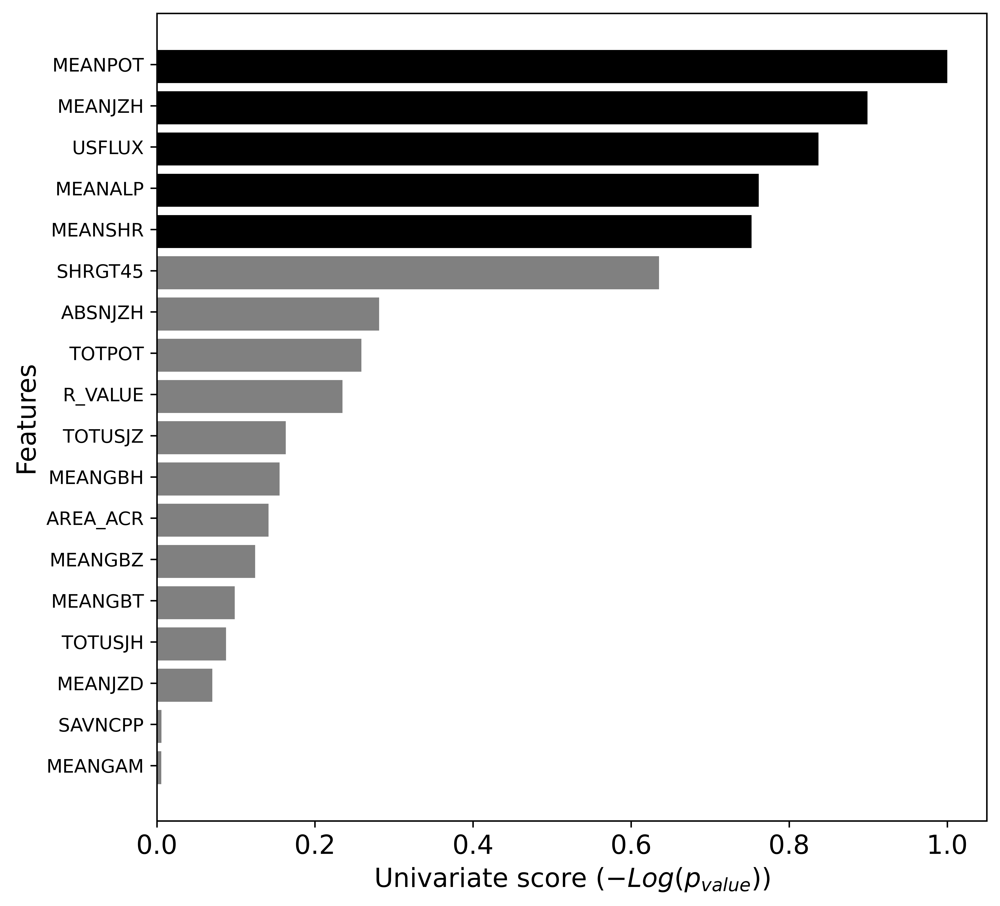

In [ ]:

import matplotlib.pyplot as plt
plt.figure(figsize=(8,8),dpi=400)

X_indices = np.arange(xdata_36.shape[-1])
plt.figure(1)
plt.clf()
#X_indices=(-X_indices).argsort()[:5]
clrs = ['grey' if (x < scores_36[(-scores_36).argsort()][4]) else 'black' for x in np.sort(scores_36) ]
plt.barh(X_indices - 0.05, np.sort(scores_36),color=clrs,alpha=1)
#clrs = ['grey' if (x < X_indices[-5 : ]) else 'red' for x in X_indices ]
#plt.bar(X_indices - 0.05, np.sort(scores_36)[0:5], color=clrs, width=0.4)
#plt.show()
#for i  in range(0,18):
#  if i<6:
#  plt.barh(X_indices - 0.05, np.sort(scores_36)[0:5],color='black')
#  plt.barh(X_indices - 0.05, np.sort(scores_36)[5:],color='black',alpha=0.7)
#plt.title("Feature univariate score_diff_36")
plt.ylabel("Features",fontsize=14)
plt.xlabel(r"Univariate score ($-Log(p_{value})$)",fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(X_indices,np.array(col)[np.argsort(scores_36)],fontsize=10, rotation ='0')
plt.show()

##confusion table

In [ ]:
def confusion_table(pred, labels):
    """
    computes the number of TP, TN, FP, FN events given the arrays with predictions and true labels
    and returns the true skill score

    Args:
    pred: np array with predictions (1 for flare, 0 for nonflare)
    labels: np array with true labels (1 for flare, 0 for nonflare)

    Returns: true negative, false positive, true positive, false negative
    """
    Nobs = len(pred)
    TN = 0.
    TP = 0.
    FP = 0.
    FN = 0.
    for i in range(Nobs):
        if (pred[i] == 0 and labels[i] == 0):
            TN += 1
        elif (pred[i] == 1 and labels[i] == 0):
            FP += 1
        elif (pred[i] == 1 and labels[i] == 1):
            TP += 1
        elif (pred[i] == 0 and labels[i] == 1):
            FN += 1
        else:
            print("Error! Observation could not be classified.")
    return TN, FP, TP, FN

##Functions for sampling and ML models

In [ ]:
    ##model to be tried for sampling
from collections import Counter
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from sklearn.model_selection import train_test_split
from collections import Counter
from imblearn.over_sampling import SMOTE
    def without_sampling(X_train,y_train):
      return X_train, y_train
          ##undersampling majority class
    def RUS(X_train,y_train):
      rus= RandomUnderSampler(random_state=0)
      rus.fit(X_train,y_train)
      X_resampled, y_resampled = rus.fit_resample(X_train,y_train)
      return X_resampled, y_resampled
    def ROS(X_train,y_train):
      ros=RandomOverSampler(random_state=0)
      ros.fit(X_train,y_train)
      X_resampled, y_resampled = ros.fit_resample(X_train,y_train)
      return X_resampled, y_resampled
    ##SMOTE
    def SMOTE_test(X_train,y_train):
      oversample = SMOTE()
      X_resampled, y_resampled = oversample.fit_resample(X_train,y_train)
      return X_resampled, y_resampled
    def wo_costweight(X_train,y_train):
      return X_train,y_train



    #GAN
    #generating samples
    def GAN_generated(X_train,y_train):
      x,g_z= GAN(X_train,y_train)
      print( CheckAccuracy( x, g_z, data_cols, label_cols, seed=0, with_class=with_class, data_dim=data_dim ) )
      #PlotData( x, g_z, data_cols, label_cols, seed=0, with_class=with_class, data_dim=data_dim )
      xdata=np.append([X_train],[x[:,0:18]],axis=1)
      ydata=np.append([y_train],[x[:,-1]],axis=1)
    ##after GAN
      shuffle_index = np.arange(len(ydata))
      np.random.shuffle(shuffle_index)
      y_resampled = ydata[shuffle_index]
      X_resampled = xdata[shuffle_index,:]
      return (X_sampled,y_resampled)
    #returns same/costweight


In [ ]:
#get the initial parameters
print(XGboost.get_params())

{'base_score': 0.5, 'booster': 'gbtree', 'colsample_bylevel': 1, 'colsample_bynode': 1, 'colsample_bytree': 1, 'gamma': 0, 'learning_rate': 0.1, 'max_delta_step': 0, 'max_depth': 3, 'min_child_weight': 1, 'missing': None, 'n_estimators': 100, 'n_jobs': 1, 'nthread': None, 'objective': 'binary:logistic', 'random_state': 0, 'reg_alpha': 0, 'reg_lambda': 1, 'scale_pos_weight': 1, 'seed': None, 'silent': None, 'subsample': 1, 'verbosity': 1}


In [ ]:
##grid search of each models
CME_data,no_CME_data,xdata,ydata=data_gen(positive_class_36,negative_class_36)
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
svm1=SVC()
XGboost = xgb.XGBClassifier()
RF = RandomForestClassifier()
DT=DecisionTreeClassifier()
LR=LogisticRegression()
Adaboost=AdaBoostClassifier()
LDA = LinearDiscriminantAnalysis()
GB = GradientBoostingClassifier()

xdata1,ydata1=SMOTE_test(xdata,ydata)
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=1)





In [ ]:
#SVM
#C_range = np.logspace(-2, 10, 13)
#gamma_range = np.logspace(-9, 3, 13)
#param_grid = dict(gamma=gamma_range, C=C_range)
#param_grid = {'C': [0.1, 1, 3,4,6, 50,100],
#             'gamma': [1, 0.1, 0.01, 0.05, 0.07, 0.09, 0.005, 0.008, 0.0001],
 #             'gamma':['scale', 'auto'],
 #           'kernel': ['rbf']}

search_svm = GridSearchCV(SVC(), param_grid, refit = True, cv=cv,verbose = 3,n_jobs=-1, scoring=tss_scorer)

#lda
solver_range=['svd', 'lsqr', 'eigen']
shrinkage_range= np.arange(0, 1, 0.01)
param_grid_lda= dict(solver=solver_range,shrinkage=shrinkage_range)

#xgboost
param_grid_xgboost = {'gamma': [0.001,0.01,0.05,0.1,1,10],
              'learning_rate': [0.001, 0.01, 0.05,0.1],
              'max_depth': [2,6,10],
              'n_estimators': [20,30,50,100],}
XGboost = xgb.XGBClassifier()
##RF
param_grid_rf={
    'bootstrap': [True],
    'class_weight':['balanced'],
    'max_depth': [2,5,10],
    'max_features': [2, 3,5,10],
    'min_samples_leaf': [3, 5, 8],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [5,10,20, 30]}
RF = RandomForestClassifier()

#DT

param_grid_dt={    'criterion' :['gini', 'entropy'],
               'splitter':['best'],
               'class_weight':['balanced'],
    'max_depth' : [2,6,10,12],
    'max_features': [2, 3,5,10]}

DT=DecisionTreeClassifier()


#LR
param_grid_lr={'penalty': ['l1', 'l2'],'C':[0.001,.01,0.05,.1,1.5,10]}
LR=LogisticRegression()

##adboost
param_grid_ab={'n_estimators': [5,10,20, 50],
    'learning_rate': [0.001, 0.01, 0.05,0.1],
    'algorithm': ['SAMME', 'SAMME.R']
             }
Adaboost=AdaBoostClassifier(base_estimator=SVC())

##gradientboost
param_grid_gb={ 'n_estimators': [5,10,20, 50],
          "min_samples_split": np.linspace(0.1, 0.5, 4),
          "min_samples_leaf": np.linspace(0.1, 0.5, 4),
          "max_depth":[3,5,8],
          "max_features":["log2","sqrt"],}
GB = GradientBoostingClassifier()


In [ ]:
def grid_search(parameters,model):
  search_model=GridSearchCV(model, parameters, refit = True, cv=cv,verbose = 3,n_jobs=-1, scoring=tss_scorer)

  # summarize result
  result = search_model.fit(xdata1,ydata1)
  print('Best Score: %s' % search_model.best_score_)
  print('Best Hyperparameters: %s' % search_model.best_params_)
  return search_model

In [ ]:
grid_search(param_grid_xgboost,XGboost)

Fitting 10 folds for each of 288 candidates, totalling 2880 fits
Best Score: 0.9148148148148149
Best Hyperparameters: {'gamma': 0.05, 'learning_rate': 0.1, 'max_depth': 10, 'n_estimators': 100}


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=2, n_splits=5, random_state=1),
             estimator=XGBClassifier(), n_jobs=-1,
             param_grid={'gamma': [0.001, 0.01, 0.05, 0.1, 1, 10],
                         'learning_rate': [0.001, 0.01, 0.05, 0.1],
                         'max_depth': [2, 6, 10],
                         'n_estimators': [20, 30, 50, 100]},
             scoring=make_scorer(Tss_score), verbose=3)

##make TSS Scorer

In [ ]:
#make scorer
from sklearn.metrics import fbeta_score, make_scorer
def Tss_score(y_true, y_pred):
  TN, FP, TP, FN = confusion_table(y_pred, y_true)
  if (((TP+FN) == 0.0) or (FP+TN) == 0.0) or(FP+TP)==0.0:
    TSS=np.nan
  else:
    TSS=(TP/(TP+FN)) - (FP/(FP+TN))
  return TSS
tss_scorer=make_scorer(Tss_score)


##models with best parameters in grid search

In [ ]:
##models with best parameters in grid search
from sklearn import svm
from sklearn.svm import SVC
from sklearn.svm import LinearSVC
import xgboost as xgb
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import AdaBoostClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import GradientBoostingClassifier

def model_list():
  svm1 = svm.SVC(C=4, gamma=0.075, kernel='rbf', class_weight={1: 6.5},
                cache_size=500, max_iter=-1, shrinking=True, tol=1e-8, probability=True)

  LDA = LinearDiscriminantAnalysis(solver='lsqr')

  XGboost = xgb.XGBClassifier(objective="reg:logistic",gamma= 0.05, learning_rate= 0.1, max_depth= 10, n_estimators=100)


  RF = RandomForestClassifier(bootstrap=True,max_depth=10,max_features=10,min_samples_leaf=3,min_samples_split=8,n_estimators=30)

  DT=DecisionTreeClassifier(criterion='gini',max_depth=12,max_features=10,splitter='best',class_weight='balanced')

  LR=LogisticRegression(class_weight='balanced',C=10,penalty='l2')

  Adaboost=AdaBoostClassifier(base_estimator=RF,n_estimators=5,algorithm='SAMME',learning_rate=0.1)

  GB = GradientBoostingClassifier(max_depth=8,max_features='log2',min_samples_leaf=0.1,min_samples_split=0.1,n_estimators=50)
  return svm1,LDA,XGboost,RF,DT,LR,Adaboost,GB


##models without hyperparameter

In [ ]:
#SVM
from sklearn import svm
from sklearn.svm import SVC
from sklearn.svm import LinearSVC
def model_list_wo_hyper():
  #C = 4.0
  #gamma = 0.075
  #class_weight = {1: 6.5}
  #svm1 = svm.SVC(C=C, gamma=gamma, kernel='rbf', class_weight=None,
         #       cache_size=500, max_iter=-1, shrinking=True, tol=1e-8, probability=True)
  #svm1 = svm.SVC(C=C, gamma=gamma,probability=True, kernel='rbf', cache_size=500, max_iter=-1, shrinking=True, tol=1e-8)
  #svm2=LinearSVC(C=C,class_weight=None, max_iter=-1,tol=1e-8)

  #C = 4.0; gamma =0.0088; class_weight = {1:6.5}
  svm_cw = SVC(C=4.0, gamma=0.075, kernel='rbf', class_weight={1:6.5},   cache_size=500, max_iter=-1, shrinking=True, tol=1e-8, probability=True)
  svm1 = SVC(C=4.0, gamma=0.075, kernel='rbf', class_weight=None,   cache_size=500, max_iter=-1, shrinking=True, tol=1e-8, probability=True)
  clf = SVC(C=4.0, gamma=0.0088,probability=True, kernel='rbf',class_weight={1:6.5}, cache_size=500, max_iter=-1, shrinking=True, tol=1e-8)
  #XGBOOST
  import xgboost as xgb
  XGboost = xgb.XGBClassifier(objective="reg:logistic")
  #RF
  from sklearn.ensemble import RandomForestClassifier
  RF = RandomForestClassifier(n_estimators=100,max_depth=None,class_weight='balanced')
  #Decisiontree
  from sklearn.tree import DecisionTreeClassifier
  DT=DecisionTreeClassifier(splitter='best',class_weight='balanced')

  #Logisticregression
  from sklearn.linear_model import LogisticRegression
  LR=LogisticRegression(class_weight='balanced')

  #ELNET

  from sklearn.linear_model import ElasticNet
  ELNET=ElasticNet()

  #Naivebayes
  from sklearn.naive_bayes import GaussianNB
  Bayes = GaussianNB()

  #Adaboost

  from sklearn.ensemble import AdaBoostClassifier
  Adaboost=AdaBoostClassifier(base_estimator=LR,n_estimators=100)

  #KNN
  from sklearn.neighbors import KNeighborsClassifier
  KNN = KNeighborsClassifier(n_neighbors=5)

  #Balanced bagging
  from imblearn.ensemble import BalancedBaggingClassifier
  Balancedbagging = BalancedBaggingClassifier(base_estimator=DecisionTreeClassifier(),n_estimators=100,sampling_strategy='auto',replacement=False)
  Balancedbagging1 = BalancedBaggingClassifier(base_estimator=SVC(),n_estimators=100,sampling_strategy='auto',replacement=False)
  #LDA
  from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
  LDA = LinearDiscriminantAnalysis()

  #Gradient boosting
  from sklearn.ensemble import GradientBoostingClassifier
  GB = GradientBoostingClassifier(n_estimators=100)
  return svm_cw,svm1,clf,LDA,XGboost,RF,DT,LR,Adaboost,GB


##exploratory data analysis


In [ ]:
CME_data,no_CME_data,xdata_shuffled,ydata_shuffled=data_gen(positive_class_36,negative_class_36)
#df=pd.DataFrame(xdata_shuffled,ydata_shuffled)

In [ ]:
df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,-0.901375,1.070606,1.374636,0.656228,1.386148,-0.163990,2.441015,1.692783,1.703221,1.312757,0.485964,-0.296390,0.265615,-0.348729,1.537536,-0.531013,0.150250,0.218035
1,-0.506644,-0.339667,-0.246594,0.074342,0.550338,-0.526029,-0.178090,-0.275293,0.281748,-0.489682,0.555335,-0.548187,-0.551778,-0.297406,0.385480,-0.358338,-0.962538,-0.531583
2,0.638368,-0.192141,0.381378,0.204236,-0.093427,0.671920,-0.106702,0.427482,-0.334920,0.064269,0.240429,0.769223,0.799465,0.545743,-0.068417,0.678638,0.981320,0.024970
3,-0.678161,1.345805,0.439208,-1.189500,-1.337390,-0.618310,-0.180461,0.746974,-1.172285,0.985540,0.597457,-0.613587,-0.040374,-0.723795,-1.148382,-0.243018,-0.847503,-0.342739
4,-0.780182,1.183630,1.705650,0.862133,0.895814,-0.039533,2.033939,2.018344,1.163226,1.382592,0.349704,-0.273250,0.922791,-0.238875,0.900159,-0.082365,0.281719,0.546722
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80,0.000000,0.718149,-3.478497,2.463608,1.278172,1.723881,1.775822,-2.862557,1.000952,1.600711,-1.135317,0.779758,2.914927,0.996229,1.199694,0.172273,1.277124,3.624221
81,0.044586,0.541698,-3.568787,2.587204,1.185611,1.735503,1.574867,-2.850388,0.902222,1.343634,-1.240693,0.734905,2.914816,1.061820,1.132125,0.175514,1.145655,3.764166
82,0.180885,1.055734,-1.937086,2.517450,0.937416,2.082879,1.897513,-1.784646,0.658286,1.818602,-1.687829,1.261968,2.396945,1.304426,0.953168,0.318569,1.504847,2.015616
83,0.333475,0.933639,-2.975279,1.984843,0.576212,2.123605,1.587400,-2.397049,0.363278,1.602236,-1.252491,1.067767,3.004043,1.086823,0.582814,0.354650,1.479022,3.604373


DataPrep Report
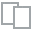
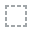
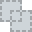
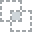
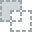
...
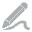
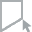
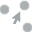
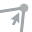
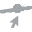

In [ ]:
create_report(df)

DataPrep Report
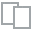
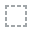
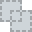
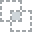
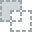
...
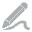
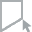
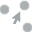
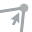
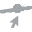

In [ ]:
create_report(df1)

##run here

In [ ]:
C = 4.0; gamma =0.0088; class_weight = {1:6.5}
clf = SVC(C=C, gamma=gamma,probability=True, kernel='rbf',class_weight=class_weight, cache_size=500, max_iter=-1, shrinking=True, tol=1e-8)

##resume

In [ ]:
sampling=[without_sampling,RUS,ROS,SMOTE_test]
def training_sampling(positive_cl,negative_cl,model,sampling):
  array_of_avg_TSS = np.ndarray([7])
  array_of_std_TSS = np.ndarray([7])
  array_of_far= np.ndarray([7])
  array_of_pod= np.ndarray([7])
  array_of_fdr= np.ndarray([7])
  wrapper=np.ndarray([7])

  # xdata are the examples
  # ydata are the labels


  ##uncomment the desired model

  CME_data,no_CME_data,xdata,ydata=data_gen(positive_cl,negative_cl)
  #CME_data,no_CME_data,xdata,ydata=data_gen_change(positive_cl,negative_cl)

  ##chose k

  # compute the TSS for a variety of k ranging from 2 to 52
  # this is to see how the TSS varies as a function of k, and to test if k=10 really makes sense
  for k in range(2, 9):
      skf = StratifiedKFold(n_splits=k, shuffle=True)
      these_TSS_for_this_k = []
      far_array=[]
      fdr_array=[]
      pod_array=[]
      wrapper=[]
      for train_index, test_index in skf.split(xdata, ydata):
          # xtrain are the examples in the training set
          xtrain2 = xdata[train_index]
          # ytrain are the labels in the training set
          ytrain2 = ydata[train_index]
          xtrain1,ytrain1=sampling(xtrain2,ytrain2)
          # xtest are the examples in the testing set
          xtest = xdata[test_index]
          ytest = ydata[test_index]    # ytest are the labels in the testing set
          # metadata useful for interpreting with LIME
          #mtrain = mdata[train_index]
          # metadata useful for interpreting with LIME
          #mtest = mdata[test_index]
          #ROS
          #if sampling==ROS:
           # xtrain, ytrain=ROS(xtrain1,ytrain1)
          #elif sampling==RUS:
           # xtrain, ytrain=ROS(xtrain1,ytrain1)
          model.fit(xtrain1, ytrain1)
          y_pred=model.predict(xtest)
          TN, FP, TP, FN = confusion_table(y_pred, ytest)
          if (((TP+FN) == 0.0) or (FP+TN) == 0.0) or(FP+TP)==0.0:
              these_TSS_for_this_k.append(np.nan)
              far_array.append(np.nan)
              fdr_array.append(np.nan)
              pod_array.append(np.nan)
              continue
          else:
              these_TSS_for_this_k.append(TP/(TP+FN) - FP/(FP+TN))
              FAR=(FP)/(FP+TN)
              POD=(TP)/(TP+FN)
              FDR= (FP)/(FP+TP)
              far_array.append(FAR)
              fdr_array.append(FDR)
              pod_array.append(POD)


      TSS_k = np.array(these_TSS_for_this_k)
      array_of_far[k-2]=np.mean(np.array(far_array))
      array_of_fdr[k-2]=np.mean(np.array(fdr_array))
      array_of_pod[k-2]=np.mean(np.array(pod_array))
      array_of_avg_TSS[k-2] = np.mean(TSS_k)
      array_of_std_TSS[k-2] = np.std(TSS_k)
  return array_of_avg_TSS,array_of_std_TSS,array_of_far,array_of_fdr,array_of_pod

##splitting for all models are same

In [ ]:
sampling=[without_sampling,RUS,ROS,SMOTE_test]
def training_sampling(positive_cl,negative_cl,kfolds,sampling,methodology):

      method1=['svm_cw','svm1','LDA','XGboost','RF','DT','LR','Adaboost','GB']


      # xdata are the examples
      # ydata are the labels


      ##uncomment the desired model
      svm_cw,svm1,clf,LDA,XGboost,RF,DT,LR,Adaboost,GB= model_list_wo_hyper()
      if methodology==0:
        CME_data,no_CME_data,xdata,ydata=data_gen(positive_cl,negative_cl)
        method=[svm_cw,svm1,LDA,XGboost,RF,DT,LR,Adaboost,GB]
      else:
        CME_data,no_CME_data,xdata,ydata=data_gen_change(positive_cl,negative_cl)
        method=[svm_cw,clf,LDA,XGboost,RF,DT,LR,Adaboost,GB]

  ##chose k

  # compute the TSS for a variety of k ranging from 2 to 52
  # this is to see how the TSS varies as a function of k, and to test if k=10 really makes sense
  #for k in range(2, 9):
      skf = StratifiedKFold(n_splits=kfolds, shuffle=True)
      these_TSS_for_this_k = []
      far_array=[]
      fdr_array=[]
      pod_array=[]
      for train_index, test_index in skf.split(xdata, ydata):
          # xtrain are the examples in the training set
          xtrain2 = xdata[train_index]
          # ytrain are the labels in the training set
          ytrain2 = ydata[train_index]
          xtrain1,ytrain1=sampling(xtrain2,ytrain2)
          # xtest are the examples in the testing set
          xtest = xdata[test_index]
          ytest = ydata[test_index]    # ytest are the labels in the testing set
          # metadata useful for interpreting with LIME
          #mtrain = mdata[train_index]
          # metadata useful for interpreting with LIME
          #mtest = mdata[test_index]
          #ROS
          #if sampling==ROS:
           # xtrain, ytrain=ROS(xtrain1,ytrain1)
          #elif sampling==RUS:
           # xtrain, ytrain=ROS(xtrain1,ytrain1)
          for i in range(0,9):
            method[i].fit(xtrain1, ytrain1)
            y_pred=method[i].predict(xtest)
            TN, FP, TP, FN = confusion_table(y_pred, ytest)
            if (((TP+FN) == 0.0) or (FP+TN) == 0.0) or(FP+TP)==0.0:
                these_TSS_for_this_k.append(np.nan)
                far_array.append(np.nan)
                fdr_array.append(np.nan)
                pod_array.append(np.nan)
                continue
            else:
                these_TSS_for_this_k.append(TP/(TP+FN) - FP/(FP+TN))
                FAR=(FP)/(FP+TN)
                POD=(TP)/(TP+FN)
                FDR= (FP)/(FP+TP)
                far_array.append(FAR)
                fdr_array.append(FDR)
                pod_array.append(POD)

      return np.array(these_TSS_for_this_k),np.array(far_array),np.array(fdr_array),np.array(pod_array)

In [ ]:
#calculating for range of folds
tss_mean_svm=[]
tss_mean_lda=[]
tss_mean_xgboost=[]
tss_mean_rf=[]
tss_mean_dt=[]
tss_mean_lr=[]
tss_mean_gb=[]
tss_mean_adaboost=[]
tss_std_svm=[]
tss_std_lda=[]
tss_std_xgboost=[]
tss_std_rf=[]
tss_std_dt=[]
tss_std_lr=[]
tss_std_gb=[]
tss_std_adaboost=[]
TSS_models_mean=[tss_mean_svm,tss_mean_lda,tss_mean_xgboost,tss_mean_rf,tss_mean_dt,tss_mean_lr,tss_mean_gb,tss_mean_adaboost]
TSS_models_std=[tss_std_svm,tss_std_lda,tss_std_xgboost,tss_std_rf,tss_std_dt,tss_std_lr,tss_std_gb,tss_std_adaboost]

for k in range(2,9):
  TSS_k,far,fdr,pod=training_sampling(data_p24_new,data_n24_new,k,ROS)
  reshaped_TSS=np.array(TSS_k).reshape(k,8)
  reshaped_far=np.array(far).reshape(k,8)
  reshaped_fdr=np.array(fdr).reshape(k,8)
  reshaped_pod=np.array(pod).reshape(k,8)
  #method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']
  for i in range(0,8):
    TSS_models_mean[i].append(np.mean(reshaped_TSS[:,i]))
    TSS_models_std[i].append(np.std(reshaped_TSS[:,i]))

In [ ]:
  ##PERFORMANCE for K folds

  #method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']


  x=np.arange(2,9,1)
  plt.figure(figsize=(7,5),dpi=200)
  plt.plot(x,TSS_models_mean[0],marker='o',linestyle = 'None',label='svm')
  plt.plot(x,TSS_models_mean[1],marker='o',linestyle = 'None',label='LDA')
  plt.plot(x,TSS_models_mean[2],marker='o',alpha=0.5,linestyle = 'None',label='XGboost')
  plt.plot(x,TSS_models_mean[3],marker='o',alpha=0.5,linestyle = 'None',label='RF')
  plt.plot(x,TSS_models_mean[4],marker='o',alpha=0.5,linestyle = 'None',label='DT')
  plt.plot(x,TSS_models_mean[5],marker='o',alpha=0.5,linestyle = 'None',label='LR')
  plt.plot(x,TSS_models_mean[6],marker='o',alpha=0.5,linestyle = 'None',label='GB')
  plt.plot(x,TSS_models_mean[7],marker='o',alpha=0.5,linestyle = 'None',label='Adaboost')
  plt.ylim(0,1,1)
  plt.title("Performance for different folds")
  plt.xticks(fontsize=10)
  plt.yticks(fontsize=10)
  plt.xlabel("No of folds")
  plt.ylabel("TSS Score")
  plt.legend(bbox_to_anchor=(1.05, 1.05))

In [ ]:
for sampling  in [RUS,ROS,SMOTE_test,wo_costweight]:
    TSS_k,far,fdr,pod=training_sampling(positive_class_48,negative_class_48,6,sampling,0)
    reshaped_TSS=np.array(TSS_k).reshape(6,9)
    reshaped_far=np.array(far).reshape(6,9)
    reshaped_fdr=np.array(fdr).reshape(6,9)
    reshaped_pod=np.array(pod).reshape(6,9)
    #method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']
    TSS_models_mean=[]
    TSS_models_std=[]
    far_models_mean=[]
    far_models_std=[]
    fdr_models_mean=[]
    fdr_models_std=[]
    pod_models_mean=[]
    pod_models_std=[]
    for i in range(0,9):
      TSS_models_mean.append(np.mean(reshaped_TSS[:,i]))
      TSS_models_std.append(np.std(reshaped_TSS[:,i]))
      far_models_mean.append(np.mean(reshaped_far[:,i]))
      far_models_std.append(np.std(reshaped_far[:,i]))
      fdr_models_mean.append(np.mean(reshaped_fdr[:,i]))
      fdr_models_std.append(np.std(reshaped_fdr[:,i]))
      pod_models_mean.append(np.mean(reshaped_pod[:,i]))
      pod_models_std.append(np.std(reshaped_pod[:,i]))


    print(np.round(TSS_models_mean,2))
    print(np.round(TSS_models_std,2))
    print(np.round(far_models_mean,2))
    print(np.round(far_models_std,2))
    print(np.round(fdr_models_mean,2))
    print(np.round(fdr_models_std,2))
    print(np.round(pod_models_mean,2))
    print(np.round(pod_models_std,2))
    print('//')

[0.48 0.43 0.56 0.49 0.48 0.34 0.44 0.43 0.45]
[0.07 0.08 0.05 0.1  0.07 0.22 0.07 0.09 0.09]
[0.42 0.31 0.23 0.23 0.2  0.32 0.27 0.27 0.24]
[0.03 0.06 0.04 0.05 0.1  0.12 0.06 0.06 0.04]
[0.7  0.67 0.59 0.62 0.55 0.68 0.65 0.66 0.63]
[0.02 0.04 0.03 0.05 0.14 0.13 0.04 0.03 0.06]
[0.9  0.74 0.79 0.72 0.69 0.66 0.71 0.7  0.69]
[0.05 0.09 0.07 0.1  0.07 0.11 0.1  0.12 0.05]
//
[0.72 0.66 0.53 0.46 0.47 0.43 0.51 0.44 0.45]
[0.1  0.13 0.15 0.13 0.09 0.12 0.12 0.12 0.15]
[0.06 0.05 0.19 0.04 0.01 0.06 0.21 0.22 0.04]
[0.02 0.02 0.05 0.03 0.01 0.03 0.04 0.03 0.02]
[0.27 0.28 0.57 0.26 0.11 0.36 0.59 0.63 0.25]
[0.07 0.07 0.09 0.12 0.09 0.16 0.07 0.06 0.13]
[0.78 0.72 0.72 0.5  0.49 0.49 0.72 0.66 0.49]
[0.11 0.13 0.14 0.13 0.1  0.14 0.12 0.13 0.16]
//
[0.69 0.69 0.58 0.59 0.56 0.41 0.54 0.53 0.6 ]
[0.04 0.05 0.1  0.09 0.11 0.1  0.14 0.14 0.07]
[0.05 0.05 0.18 0.13 0.04 0.15 0.2  0.22 0.08]
[0.03 0.03 0.04 0.06 0.01 0.02 0.03 0.06 0.05]
[0.24 0.24 0.54 0.45 0.26 0.57 0.58 0.58 0.36]
[0.09 0

In [ ]:
##12hrs (4 samplijng)

[0.3  0.26 0.55 0.28 0.26 0.21 0.32 0.27 0.29]
[0.11 0.14 0.13 0.2  0.17 0.13 0.13 0.16 0.14]
[0.53 0.38 0.27 0.38 0.39 0.4  0.38 0.4  0.37]
[0.05 0.06 0.04 0.03 0.05 0.1  0.03 0.02 0.06]
[0.76 0.75 0.62 0.75 0.75 0.76 0.73 0.75 0.74]
[0.03 0.05 0.05 0.06 0.05 0.05 0.04 0.05 0.04]
[0.83 0.64 0.82 0.66 0.65 0.62 0.7  0.67 0.66]
[0.1  0.13 0.12 0.21 0.17 0.15 0.14 0.17 0.16]
//
[0.45 0.44 0.57 0.35 0.19 0.27 0.47 0.37 0.29]
[0.06 0.05 0.04 0.08 0.08 0.1  0.11 0.1  0.06]
[0.12 0.11 0.23 0.08 0.01 0.12 0.23 0.31 0.07]
[0.06 0.05 0.03 0.06 0.01 0.03 0.05 0.08 0.05]
[0.49 0.48 0.59 0.45 0.16 0.6  0.62 0.69 0.43]
[0.08 0.09 0.03 0.15 0.16 0.08 0.07 0.05 0.13]
[0.58 0.55 0.8  0.43 0.21 0.4  0.7  0.67 0.36]
[0.08 0.08 0.05 0.09 0.09 0.11 0.07 0.1  0.1 ]
//
[0.53 0.44 0.55 0.33 0.28 0.23 0.48 0.35 0.38]
[0.09 0.06 0.05 0.1  0.13 0.09 0.09 0.13 0.1 ]
[0.15 0.09 0.23 0.12 0.08 0.17 0.25 0.32 0.1 ]
[0.04 0.03 0.05 0.04 0.03 0.05 0.06 0.07 0.03]
[0.51 0.45 0.59 0.57 0.53 0.67 0.62 0.7  0.51]
[0.06 0.05 0.03 0.06 0.11 0.08 0.06 0.07 0.06]
[0.67 0.53 0.78 0.46 0.36 0.4  0.73 0.66 0.48]
[0.1  0.08 0.08 0.13 0.13 0.09 0.07 0.09 0.12]
//
[0.59  nan 0.25 0.22 0.18 0.23 0.43 0.35 0.22]
[0.09  nan 0.08 0.07 0.06 0.1  0.11 0.11 0.09]
[0.1   nan 0.05 0.01 0.   0.14 0.26 0.3  0.02]
[0.03  nan 0.01 0.02 0.   0.05 0.05 0.06 0.02]
[0.41  nan 0.46 0.08 0.   0.63 0.65 0.69 0.23]
[0.07  nan 0.08 0.19 0.   0.11 0.05 0.04 0.21]
[0.69  nan 0.3  0.23 0.18 0.36 0.69 0.65 0.24]
[0.09  nan 0.08 0.07 0.06 0.06 0.11 0.11 0.08]
//

##24hrs(4 sampling)

[0.38 0.39 0.39 0.35 0.35 0.32 0.36 0.36 0.36]
[0.1  0.09 0.06 0.19 0.14 0.07 0.13 0.14 0.15]
[0.41 0.28 0.32 0.34 0.33 0.35 0.29 0.28 0.32]
[0.06 0.05 0.08 0.05 0.07 0.1  0.05 0.05 0.06]
[0.73 0.69 0.7  0.73 0.72 0.73 0.7  0.7  0.71]
[0.03 0.04 0.04 0.06 0.06 0.03 0.06 0.06 0.04]
[0.78 0.67 0.71 0.68 0.68 0.67 0.66 0.64 0.68]
[0.09 0.08 0.1  0.18 0.09 0.14 0.13 0.13 0.16]
//
[0.61 0.55 0.5  0.44 0.26 0.33 0.46 0.44 0.38]
[0.11 0.11 0.18 0.07 0.08 0.17 0.07 0.03 0.05]
[0.06 0.06 0.23 0.05 0.01 0.07 0.24 0.24 0.05]
[0.04 0.03 0.05 0.03 0.01 0.01 0.03 0.04 0.02]
[0.3  0.3  0.62 0.32 0.21 0.51 0.64 0.65 0.33]
[0.16 0.16 0.07 0.16 0.11 0.14 0.03 0.02 0.11]
[0.67 0.61 0.74 0.49 0.28 0.4  0.7  0.68 0.43]
[0.12 0.11 0.17 0.06 0.08 0.16 0.08 0.07 0.06]
//
[0.66 0.61 0.48 0.5  0.4  0.39 0.44 0.43 0.48]
[0.14 0.1  0.12 0.14 0.17 0.19 0.06 0.09 0.18]
[0.07 0.05 0.26 0.12 0.05 0.17 0.24 0.26 0.1 ]
[0.02 0.02 0.04 0.06 0.03 0.03 0.03 0.03 0.05]
[0.34 0.3  0.65 0.46 0.36 0.62 0.65 0.67 0.46]
[0.1  0.07 0.05 0.14 0.18 0.1  0.03 0.04 0.15]
[0.73 0.67 0.74 0.62 0.45 0.55 0.68 0.7  0.58]
[0.13 0.1  0.09 0.13 0.15 0.18 0.05 0.06 0.16]
//
[0.69 0.37 0.29 0.33 0.11 0.36 0.5  0.46 0.36]
[0.14 0.05 0.04 0.09 0.06 0.13 0.11 0.09 0.08]
[0.05 0.   0.03 0.01 0.   0.07 0.24 0.26 0.  ]
[0.03 0.01 0.01 0.01 0.01 0.04 0.08 0.08 0.01]
[0.24 0.05 0.33 0.13 0.08 0.45 0.62 0.64 0.06]
[0.17 0.07 0.09 0.11 0.19 0.18 0.08 0.07 0.08]
[0.73 0.38 0.32 0.34 0.11 0.43 0.73 0.72 0.37]
[0.11 0.06 0.05 0.09 0.05 0.11 0.08 0.06 0.08]

##36hrs(4 sampling)
[0.6  0.55 0.78 0.39 0.43 0.35 0.63 0.62 0.4 ]
[0.07 0.15 0.09 0.12 0.09 0.2  0.1  0.1  0.08]
[0.3  0.25 0.1  0.27 0.27 0.32 0.19 0.21 0.28]
[0.07 0.07 0.04 0.09 0.08 0.08 0.07 0.06 0.09]
[0.61 0.59 0.33 0.65 0.64 0.69 0.51 0.54 0.65]
[0.05 0.07 0.09 0.08 0.06 0.1  0.09 0.07 0.07]
[0.91 0.8  0.88 0.66 0.7  0.67 0.82 0.84 0.68]
[0.1  0.19 0.1  0.14 0.15 0.19 0.1  0.09 0.09]

//
[0.81 0.79 0.78 0.53 0.43 0.45 0.76 0.66 0.5 ]
[0.09 0.11 0.03 0.13 0.11 0.11 0.08 0.09 0.14]
[0.02 0.01 0.09 0.04 0.01 0.07 0.09 0.16 0.03]
[0.01 0.01 0.03 0.02 0.01 0.04 0.04 0.06 0.02]
[0.09 0.07 0.33 0.24 0.06 0.38 0.33 0.46 0.21]
[0.06 0.05 0.08 0.12 0.07 0.14 0.11 0.1  0.13]
[0.82 0.8  0.87 0.56 0.43 0.53 0.86 0.82 0.53]
[0.09 0.11 0.05 0.13 0.12 0.1  0.07 0.08 0.14]
//
[0.76 0.77 0.77 0.6  0.58 0.57 0.76 0.64 0.58]
[0.09 0.1  0.1  0.18 0.12 0.15 0.15 0.16 0.17]
[0.01 0.   0.08 0.08 0.03 0.13 0.09 0.14 0.08]
[0.01 0.01 0.03 0.02 0.01 0.03 0.02 0.05 0.02]
[0.07 0.03 0.29 0.36 0.21 0.46 0.33 0.46 0.36]
[0.05 0.06 0.08 0.11 0.07 0.07 0.05 0.03 0.09]
[0.77 0.78 0.85 0.68 0.61 0.7  0.85 0.79 0.66]
[0.1  0.1  0.11 0.16 0.12 0.16 0.16 0.2  0.16]
//
[0.74 0.5  0.76 0.34 0.32 0.42 0.72 0.62 0.37]
[0.14 0.13 0.09 0.11 0.11 0.12 0.07 0.06 0.15]
[0.02 0.   0.03 0.02 0.   0.1  0.13 0.17 0.01]
[0.02 0.01 0.02 0.03 0.   0.04 0.03 0.05 0.02]
[0.12 0.02 0.16 0.15 0.   0.46 0.41 0.5  0.09]
[0.09 0.05 0.06 0.18 0.   0.09 0.05 0.06 0.15]
[0.77 0.51 0.8  0.36 0.32 0.52 0.85 0.79 0.38]
[0.13 0.13 0.1  0.11 0.11 0.14 0.08 0.07 0.15]

3348hrs (4sampling)

[0.48 0.43 0.56 0.49 0.48 0.34 0.44 0.43 0.45]
[0.07 0.08 0.05 0.1  0.07 0.22 0.07 0.09 0.09]
[0.42 0.31 0.23 0.23 0.2  0.32 0.27 0.27 0.24]
[0.03 0.06 0.04 0.05 0.1  0.12 0.06 0.06 0.04]
[0.7  0.67 0.59 0.62 0.55 0.68 0.65 0.66 0.63]
[0.02 0.04 0.03 0.05 0.14 0.13 0.04 0.03 0.06]
[0.9  0.74 0.79 0.72 0.69 0.66 0.71 0.7  0.69]
[0.05 0.09 0.07 0.1  0.07 0.11 0.1  0.12 0.05]
//
[0.72 0.66 0.53 0.46 0.47 0.43 0.51 0.44 0.45]
[0.1  0.13 0.15 0.13 0.09 0.12 0.12 0.12 0.15]
[0.06 0.05 0.19 0.04 0.01 0.06 0.21 0.22 0.04]
[0.02 0.02 0.05 0.03 0.01 0.03 0.04 0.03 0.02]
[0.27 0.28 0.57 0.26 0.11 0.36 0.59 0.63 0.25]
[0.07 0.07 0.09 0.12 0.09 0.16 0.07 0.06 0.13]
[0.78 0.72 0.72 0.5  0.49 0.49 0.72 0.66 0.49]
[0.11 0.13 0.14 0.13 0.1  0.14 0.12 0.13 0.16]
//
[0.69 0.69 0.58 0.59 0.56 0.41 0.54 0.53 0.6 ]
[0.04 0.05 0.1  0.09 0.11 0.1  0.14 0.14 0.07]
[0.05 0.05 0.18 0.13 0.04 0.15 0.2  0.22 0.08]
[0.03 0.03 0.04 0.06 0.01 0.02 0.03 0.06 0.05]
[0.24 0.24 0.54 0.45 0.26 0.57 0.58 0.58 0.36]
[0.09 0.09 0.05 0.09 0.07 0.07 0.06 0.09 0.1 ]
[0.74 0.74 0.76 0.71 0.6  0.56 0.74 0.75 0.69]
[0.06 0.04 0.1  0.08 0.11 0.09 0.12 0.1  0.07]
//
[0.71 0.32 0.34 0.4  0.39 0.46 0.56 0.51 0.43]
[0.19 0.13 0.11 0.16 0.11 0.1  0.1  0.08 0.16]
[0.05 0.01 0.04 0.   0.   0.09 0.21 0.21 0.01]
[0.02 0.01 0.03 0.01 0.   0.03 0.04 0.04 0.01]
[0.24 0.07 0.34 0.03 0.   0.45 0.57 0.59 0.1 ]
[0.14 0.12 0.13 0.06 0.   0.11 0.06 0.06 0.11]
[0.76 0.32 0.39 0.4  0.39 0.55 0.76 0.72 0.43]
[0.18 0.13 0.12 0.16 0.11 0.09 0.09 0.06 0.15]
//



In [ ]:
##data

#8hrs # #mean #std
[0.16 0.06 0.4  0.21 0.18 0.16 0.33 0.33 0.27]
[0.1  0.13 0.14 0.13 0.14 0.13 0.09 0.09 0.2 ]
[0.62 0.51 0.28 0.41 0.39 0.43 0.35 0.34 0.4 ]
[0.05 0.05 0.05 0.04 0.05 0.05 0.09 0.1  0.06]
[0.8  0.82 0.68 0.77 0.78 0.79 0.72 0.72 0.75]
[0.02 0.04 0.04 0.04 0.05 0.04 0.05 0.06 0.06]
[0.79 0.57 0.67 0.62 0.57 0.59 0.67 0.67 0.67]
[0.06 0.13 0.16 0.1  0.14 0.13 0.12 0.12 0.15]

#12hrs # #mean #std
[0.24 0.06 0.46 0.17 0.22 0.12 0.28 0.28 0.23]
[0.09 0.16 0.12 0.1  0.11 0.1  0.16 0.15 0.13]
[0.58 0.52 0.26 0.39 0.35 0.42 0.36 0.37 0.35]
[0.02 0.07 0.04 0.06 0.06 0.06 0.05 0.06 0.06]
[0.78 0.82 0.65 0.78 0.75 0.79 0.74 0.74 0.75]
[0.02 0.05 0.04 0.03 0.04 0.03 0.05 0.06 0.05]
[0.82 0.58 0.72 0.57 0.58 0.54 0.64 0.65 0.58]
[0.09 0.14 0.14 0.14 0.13 0.07 0.18 0.18 0.13]

#24hrs # #mean #std
[0.43 0.16 0.44 0.39 0.42 0.2  0.36 0.39 0.4 ]
[0.05 0.14 0.12 0.15 0.1  0.15 0.16 0.18 0.18]
[0.4  0.36 0.27 0.3  0.24 0.32 0.28 0.28 0.27]
[0.04 0.11 0.04 0.07 0.06 0.06 0.05 0.06 0.1 ]
[0.72 0.77 0.67 0.69 0.65 0.76 0.7  0.69 0.66]
[0.02 0.07 0.04 0.08 0.07 0.06 0.06 0.07 0.1 ]
[0.84 0.52 0.71 0.68 0.66 0.52 0.65 0.67 0.67]
[0.05 0.08 0.12 0.1  0.09 0.14 0.15 0.15 0.12]

#36hrs # #mean #std
[0.52 0.17 0.78 0.49 0.47 0.33 0.62 0.56 0.47]
[0.09 0.17 0.09 0.12 0.19 0.18 0.1  0.15 0.17]
[0.29 0.43 0.09 0.22 0.21 0.31 0.19 0.21 0.22]
[0.04 0.12 0.02 0.07 0.06 0.08 0.06 0.06 0.07]
[0.63 0.77 0.32 0.58 0.59 0.69 0.51 0.56 0.59]
[0.04 0.06 0.06 0.08 0.13 0.07 0.06 0.04 0.12]
[0.81 0.6  0.87 0.72 0.68 0.64 0.81 0.78 0.68]
[0.08 0.13 0.09 0.07 0.15 0.16 0.15 0.19 0.15]

#48hrs # #mean #std

[0.43 0.16 0.61 0.44 0.37 0.32 0.45 0.46 0.45]
[0.1  0.11 0.07 0.11 0.12 0.17 0.13 0.14 0.13]
[0.45 0.48 0.23 0.25 0.26 0.32 0.32 0.32 0.23]
[0.07 0.07 0.05 0.03 0.06 0.08 0.07 0.08 0.03]
[0.72 0.79 0.58 0.65 0.67 0.71 0.67 0.66 0.63]
[0.03 0.04 0.05 0.04 0.06 0.06 0.07 0.07 0.05]
[0.89 0.64 0.84 0.7  0.64 0.64 0.77 0.79 0.69]
[0.07 0.12 0.05 0.12 0.14 0.11 0.08 0.09 0.13]



###ROS ##########################

[0.44 0.2  0.47 0.3  0.19 0.13 0.41 0.31 0.22]
[0.1  0.1  0.1  0.03 0.1  0.12 0.1  0.08 0.08]
[0.17 0.24 0.25 0.08 0.03 0.08 0.3  0.34 0.07]
[0.04 0.06 0.03 0.02 0.02 0.03 0.02 0.05 0.02]
[0.59 0.74 0.64 0.5  0.34 0.69 0.68 0.73 0.56]
[0.07 0.05 0.04 0.07 0.27 0.13 0.04 0.04 0.09]
[0.61 0.44 0.72 0.38 0.22 0.21 0.71 0.66 0.29]
[0.11 0.12 0.11 0.05 0.1  0.12 0.08 0.04 0.07]

[0.45 0.26 0.53 0.29 0.27 0.21 0.44 0.33 0.24]
[0.07 0.09 0.17 0.16 0.15 0.19 0.15 0.18 0.13]
[0.13 0.21 0.22 0.09 0.02 0.13 0.25 0.31 0.09]
[0.02 0.06 0.06 0.04 0.02 0.03 0.05 0.07 0.03]
[0.53 0.69 0.6  0.53 0.25 0.68 0.64 0.71 0.57]
[0.03 0.03 0.06 0.2  0.19 0.17 0.07 0.07 0.17]
[0.58 0.47 0.76 0.37 0.29 0.34 0.69 0.64 0.33]
[0.08 0.12 0.21 0.16 0.17 0.19 0.16 0.19 0.13]

[0.59 0.51 0.53 0.39 0.3  0.24 0.49 0.43 0.38]
[0.11 0.11 0.14 0.15 0.13 0.18 0.16 0.12 0.12]
[0.07 0.13 0.23 0.05 0.02 0.1  0.23 0.26 0.05]
[0.02 0.04 0.05 0.01 0.01 0.02 0.05 0.04 0.02]
[0.36 0.51 0.61 0.4  0.23 0.64 0.63 0.67 0.41]
[0.08 0.08 0.07 0.11 0.19 0.13 0.08 0.06 0.11]
[0.66 0.63 0.76 0.45 0.32 0.34 0.72 0.7  0.43]
[0.11 0.12 0.14 0.14 0.12 0.19 0.15 0.13 0.12]

[0.78 0.63 0.78 0.52 0.48 0.45 0.7  0.63 0.55]
[0.12 0.04 0.08 0.1  0.1  0.12 0.09 0.09 0.04]
[0.02 0.1  0.09 0.03 0.01 0.07 0.12 0.16 0.02]
[0.01 0.02 0.06 0.02 0.01 0.03 0.07 0.07 0.02]
[0.11 0.39 0.3  0.18 0.07 0.39 0.38 0.46 0.14]
[0.02 0.04 0.13 0.1  0.07 0.12 0.12 0.11 0.12]
[0.8  0.73 0.87 0.55 0.49 0.53 0.81 0.79 0.58]
[0.12 0.05 0.05 0.11 0.11 0.1  0.05 0.07 0.03]

[0.74 0.58 0.58 0.58 0.48 0.5  0.53 0.49 0.52]
[0.07 0.12 0.09 0.11 0.11 0.13 0.1  0.09 0.13]
[0.05 0.14 0.19 0.04 0.02 0.07 0.2  0.21 0.03]
[0.03 0.04 0.03 0.02 0.01 0.04 0.01 0.02 0.02]
[0.22 0.49 0.55 0.25 0.18 0.34 0.58 0.6  0.21]
[0.12 0.1  0.06 0.12 0.1  0.17 0.04 0.05 0.1 ]
[0.79 0.72 0.77 0.63 0.5  0.56 0.72 0.7  0.55]
[0.06 0.1  0.09 0.11 0.11 0.13 0.1  0.09 0.14]


******************SMOTE ********************************

[0.43 0.16 0.47 0.37 0.29 0.29 0.4  0.32 0.29]
[0.12 0.08 0.14 0.07 0.05 0.19 0.19 0.18 0.07]
[0.19 0.27 0.23 0.17 0.09 0.18 0.28 0.33 0.17]
[0.05 0.05 0.07 0.04 0.04 0.06 0.08 0.08 0.05]
[0.61 0.76 0.62 0.61 0.53 0.64 0.66 0.72 0.64]
[0.06 0.03 0.09 0.06 0.11 0.15 0.11 0.08 0.05]
[0.62 0.43 0.7  0.54 0.38 0.47 0.68 0.64 0.46]
[0.15 0.1  0.12 0.07 0.06 0.15 0.12 0.12 0.11]

[0.56 0.35 0.58 0.25 0.31 0.2  0.52 0.34 0.27]
[0.15 0.09 0.1  0.18 0.12 0.09 0.14 0.13 0.16]
[0.11 0.2  0.23 0.14 0.07 0.19 0.25 0.31 0.13]
[0.04 0.05 0.04 0.05 0.04 0.04 0.02 0.04 0.05]
[0.44 0.64 0.58 0.63 0.47 0.71 0.62 0.7  0.61]
[0.09 0.06 0.06 0.14 0.15 0.03 0.05 0.05 0.11]
[0.68 0.55 0.81 0.39 0.38 0.39 0.77 0.65 0.4 ]
[0.16 0.08 0.09 0.17 0.11 0.11 0.13 0.09 0.17]

[0.57 0.36 0.47 0.38 0.36 0.25 0.44 0.45 0.36]
[0.13 0.21 0.17 0.05 0.04 0.06 0.13 0.11 0.05]
[0.09 0.12 0.26 0.09 0.04 0.16 0.23 0.22 0.09]
[0.02 0.02 0.03 0.02 0.03 0.04 0.03 0.03 0.02]
[0.41 0.57 0.65 0.49 0.34 0.67 0.65 0.64 0.51]
[0.05 0.11 0.06 0.07 0.09 0.06 0.05 0.04 0.05]
[0.66 0.48 0.72 0.47 0.4  0.4  0.66 0.67 0.44]
[0.14 0.21 0.15 0.03 0.05 0.08 0.14 0.13 0.05]

[0.77 0.59 0.82 0.62 0.59 0.57 0.75 0.65 0.64]
[0.1  0.11 0.06 0.11 0.12 0.11 0.05 0.11 0.08]
[0.02 0.08 0.06 0.05 0.03 0.14 0.09 0.14 0.05]
[0.01 0.04 0.03 0.02 0.02 0.04 0.03 0.04 0.01]
[0.11 0.33 0.25 0.27 0.19 0.47 0.32 0.44 0.27]
[0.06 0.1  0.07 0.08 0.12 0.08 0.09 0.09 0.03]
[0.79 0.67 0.88 0.67 0.62 0.71 0.84 0.79 0.69]
[0.1  0.13 0.06 0.11 0.12 0.11 0.05 0.1  0.08]

[0.67 0.54 0.59 0.62 0.49 0.43 0.6  0.54 0.57]
[0.08 0.1  0.11 0.06 0.1  0.13 0.06 0.02 0.09]
[0.07 0.14 0.19 0.08 0.06 0.14 0.19 0.21 0.08]
[0.02 0.04 0.03 0.02 0.01 0.04 0.02 0.03 0.02]
[0.33 0.5  0.55 0.36 0.36 0.55 0.55 0.58 0.39]
[0.05 0.05 0.06 0.06 0.05 0.09 0.04 0.04 0.07]
[0.75 0.68 0.77 0.7  0.55 0.57 0.79 0.75 0.65]
[0.09 0.12 0.11 0.06 0.1  0.11 0.07 0.03 0.09]


#cost weight and absence of any sampling

[0.35  nan 0.25 0.17  nan 0.24 0.46 0.3  0.19]
[0.15  nan 0.17 0.1   nan 0.08 0.08 0.13 0.07]
[0.13  nan 0.03 0.01  nan 0.11 0.25 0.31 0.03]
[0.04  nan 0.03 0.01  nan 0.04 0.03 0.07 0.02]
[0.59  nan 0.36 0.28  nan 0.61 0.65 0.72 0.41]
[0.07  nan 0.35 0.25  nan 0.12 0.03 0.05 0.2 ]
[0.48  nan 0.28 0.18  nan 0.35 0.71 0.61 0.23]
[0.17  nan 0.16 0.1   nan 0.05 0.08 0.07 0.06]

[0.53  nan 0.28 0.21 0.18 0.23 0.5  0.38 0.29]
[0.08  nan 0.12 0.1  0.09 0.06 0.12 0.12 0.13]
[0.12  nan 0.04 0.01 0.   0.12 0.26 0.31 0.01]
[0.04  nan 0.04 0.01 0.   0.04 0.03 0.05 0.01]
[0.47  nan 0.33 0.19 0.   0.61 0.63 0.69 0.17]
[0.08  nan 0.23 0.14 0.   0.08 0.05 0.04 0.2 ]
[0.65  nan 0.32 0.22 0.18 0.35 0.76 0.69 0.3 ]
[0.07  nan 0.12 0.1  0.09 0.05 0.11 0.12 0.12]

[0.59  nan 0.23 0.22 0.11 0.42 0.48 0.43 0.35]
[0.06  nan 0.09 0.11 0.06 0.13 0.09 0.05 0.14]
[0.07  nan 0.04 0.01 0.   0.09 0.25 0.25 0.01]
[0.04  nan 0.03 0.01 0.01 0.02 0.09 0.08 0.01]
[0.32  nan 0.39 0.15 0.08 0.47 0.63 0.65 0.1 ]
[0.14  nan 0.15 0.12 0.19 0.11 0.06 0.05 0.11]
[0.66  nan 0.27 0.23 0.11 0.51 0.73 0.68 0.36]
[0.08  nan 0.1  0.12 0.05 0.12 0.06 0.05 0.14]

[0.8   nan 0.76 0.42 0.33 0.49 0.73 0.63 0.47]
[0.13  nan 0.04 0.14 0.13 0.14 0.1  0.08 0.1 ]
[0.02  nan 0.03 0.01 0.   0.08 0.11 0.17 0.01]
[0.02  nan 0.03 0.01 0.01 0.01 0.02 0.03 0.01]
[0.11  nan 0.13 0.07 0.02 0.41 0.38 0.49 0.08]
[0.07  nan 0.11 0.1  0.05 0.08 0.05 0.04 0.09]
[0.82  nan 0.79 0.42 0.33 0.58 0.85 0.8  0.48]
[0.14  nan 0.05 0.14 0.13 0.13 0.1  0.1  0.1 ]

[0.73  nan 0.37 0.39 0.38 0.43 0.55 0.54 0.49]
[0.12  nan 0.06 0.15 0.17 0.14 0.06 0.06 0.17]
[0.05  nan 0.04 0.01 0.   0.07 0.2  0.21 0.01]
[0.03  nan 0.03 0.01 0.   0.03 0.03 0.04 0.02]
[0.22  nan 0.31 0.15 0.   0.41 0.57 0.58 0.09]
[0.1   nan 0.17 0.13 0.   0.14 0.03 0.05 0.11]
[0.78  nan 0.41 0.4  0.38 0.5  0.75 0.75 0.5 ]
[0.13  nan 0.06 0.15 0.17 0.12 0.06 0.06 0.17]

##plotting and visualization of samplings and timelags (SVM)


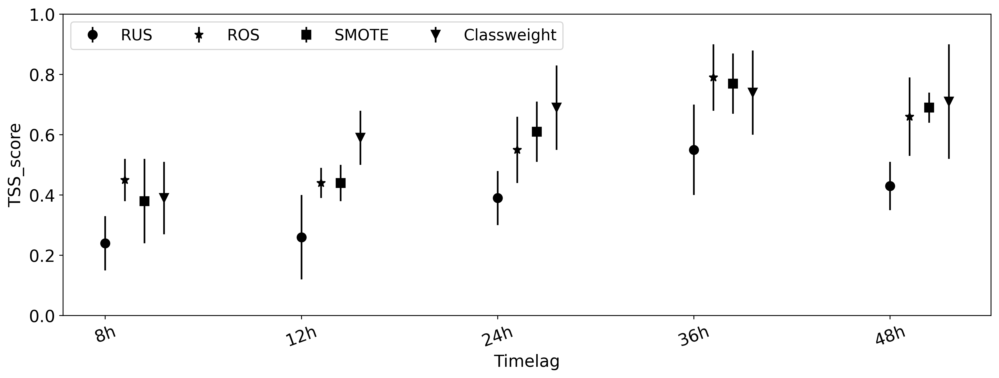

In [ ]:
svm_8h_mean=[0.24,0.45,0.38,0.39]
svm_8h_std= [0.09,0.07,0.14,0.12]


svm_12h_mean=[0.26,0.44,0.44,0.59]
svm_12h_std= [0.14,0.05,0.06,0.09]

svm_24h_mean=[0.39,0.55,0.61,0.69]
svm_24h_std= [0.09,0.11,0.1,0.14]

svm_36h_mean=[0.55,0.79,0.77,0.74]
svm_36h_std= [0.15,0.11,0.1,0.14]

svm_48h_mean=[0.43,0.66,0.69,0.71]
svm_48h_std= [0.08,0.13,0.05,0.19]
#*****************************************************************************
svm_rus_mean=[0.24,0.26,0.39,0.55,0.43]
svm_rus_std=[0.09,0.14,0.09,0.15,0.08]

svm_ros_mean=[0.45,0.44,0.55,0.79,0.66]
svm_ros_std=[0.07,0.05,0.11,0.11,0.13]

svm_sm_mean=[0.38,0.44,0.61,0.77,0.69]
svm_sm_std=[0.14,0.06,0.1,0.1,0.05]

svm_cw_mean=[0.39,0.59,0.69,0.74,0.71]
svm_cw_std=[0.12,0.09,0.14,0.14,0.19]


##plot
import numpy as np
import matplotlib.pyplot as plt
Method=['RUS','ROS','SMOTE','Cost_weight']
time_delay=['8h','12h','24h','36h','48h',]
x_pos_rus = np.arange(0,len(time_delay))
x_pos_ros=np.arange(0.1,len(time_delay)+0.1)
x_pos_sm=np.arange(0.2,len(time_delay)+0.2)
x_pos_cw=np.arange(0.3,len(time_delay)+0.3)
y_pos=np.arange(0,1,0.2)
# Build the plot
#fig = plt.figure()
fig,ax1 = plt.subplots(1,1,figsize=(15,5),dpi=200,sharey=True)
ax1.errorbar(x_pos_rus, svm_rus_mean, yerr=svm_rus_std,marker='o', markersize=8,
            linestyle='none',color='black',capthick=0.2,label='RUS')
ax1.errorbar(x_pos_ros, svm_ros_mean, yerr=svm_ros_std,marker='*', markersize=8,
            linestyle='none',color='black',capthick=0.2,label='ROS')
ax1.errorbar(x_pos_sm, svm_sm_mean, yerr=svm_sm_std,marker='s', markersize=8,
            linestyle='none',color='black',capthick=0.2,label='SMOTE')
ax1.errorbar(x_pos_cw, svm_cw_mean, yerr=svm_cw_std,marker='v', markersize=8,
            linestyle='none',color='black',capthick=0.2,label='Classweight')
#ax3.set_ylabel('True skill score')
ax1.set_ylim(0,1)
ax1.set_xticks(x_pos_rus)
#method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']
ax1.tick_params(axis='both', labelsize=15)
ax1.set_xticklabels(time_delay,rotation=20)
#ax1.set_yticklabels(fontsize=10)
#ax1.set_title('TSS')
ax1.set_xlabel('Timelag',fontsize=15)
ax1.set_ylabel('TSS_score',fontsize=15)
plt.legend(fontsize=14,loc='upper left',ncol=len(Method))
#ax1.yaxis.grid(True)
plt.show()

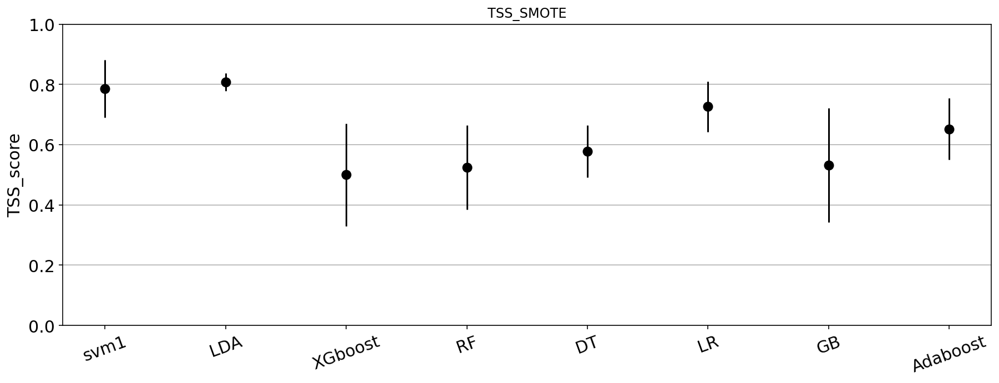

In [ ]:
##for 6th fold performance
import numpy as np
import matplotlib.pyplot as plt
fig,ax1 = plt.subplots(1,1,figsize=(15,5),sharey=True)
mean_smote=[tss_mean_svm[4],tss_mean_lda[4],tss_mean_xgboost[4],tss_mean_rf[4],tss_mean_dt[4],tss_mean_lr[4],tss_mean_gb[4],tss_mean_adaboost[4]]
std_smote=[tss_std_svm[4],tss_std_lda[4],tss_std_xgboost[4],tss_std_rf[4],tss_std_dt[4],tss_std_lr[4],tss_std_gb[4],tss_std_adaboost[4]]
method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']
x_pos = np.arange(0,len(method1))
y_pos=np.arange(0,1,0.2)
ax1.errorbar(x_pos, mean_smote, yerr=std_smote,marker='o', markersize=8,
            linestyle='none',color='black',capthick=0.2)
#ax3.set_ylabel('True skill score')
ax1.set_ylim(0,1)
ax1.set_xticks(x_pos)
method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']
ax1.tick_params(axis='both', labelsize=15)
ax1.set_xticklabels(method1,rotation=20)
#ax1.set_yticklabels(fontsize=10)
ax1.set_title('TSS_SMOTE')
ax1.set_ylabel('TSS_score',fontsize=15)
ax1.yaxis.grid(True)

##plotting/visualizations

In [ ]:
#boxplot
#boxplot neighbourhood_group and room availability

y_mean_models=[0.78 ,0.8, 0.59, 0.54, 0.45, 0.71, 0.6 ,0.63]
y_std_models=[0.09, 0.05, 0.16 ,0.14 ,0.13, 0.05, 0.09 ,0.14]
y_mean_wc_models=[0.61,0.92,0.48,0.25,0.51,0.79,0.7,0.49]
y_std_wc_models=[0.08,0.04,0.05,0.1,0.24,0.11,0.12,0.12]


##plot data certainty along with model uncertainty
method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']
x_pos = np.arange(0,len(method1))
plt.figure(figsize=(6,5),dpi=400)
y_pos=np.arange(0,1.2,0.2)
#plt.plot(x_pos, mean_tss_10, 'o')
plt.errorbar(x_pos, y_mean_models, yerr=y_std_models, fmt='o', color='green',
             ecolor='gray',alpha=0.5, elinewidth=4,label='TSS performance ')
#plt.errorbar(x_pos+0.1, y_mean_wc_models, yerr=y_std_wc_models, fmt='o', color='red',
 #            ecolor='red',markerfacecolor=(1, 1, 0, 0.5), elinewidth=4,label='TSS performance With Change info')
plt.xticks(x_pos,method1,rotation=20,fontsize=15)
plt.xlabel ( " Models",fontsize=15)
plt.ylabel("TSS score",fontsize=15)
plt.yticks(y_pos,fontsize=15)
plt.ylim(0,1)
plt.legend(fontsize=13)
plt.show()

w/o,class,imbalance:
[0.52,0.78,0.37,0.36,0.42,0.7,0.62,0.4,],[0.15,0.09,0.09,0.12,0.08,0.06,0.08,0.07],

RUS
[0.23,0.42,0.31,0.2,0.29,0.39,0.26,0.23],[0.12,0.15,0.12,0.11,0.14,0.1,0.14,0.16]
[0.28,0.49,0.25,0.2,0.23,0.43,0.15,0.22],[0.15,0.1,0.13,0.08,0.23,0.11,0.14,0.16]
0.43,0.5,0.34,0.29,0.19,0.42,0.27,0.28],[0.09,0.1,0.15,0.07,0.05,0.15,0.1,0.13]
[0.56,0.81,0.51,0.42,0.29,0.76,0.42,0.45],[0.17,0.06,0.09,0.12,0.17,0.1,0.04,0.05]

[0.41,0.55,0.41,0.34,0.35,0.5,0.42,0.41],[0.07,0.11,0.12,0.1,0.19,0.12,0.11,0.04]

ROS

[0.41,0.45,0.3,0.24,0.21,0.47,0.23,0.25],[0.09,0.13,0.18,0.1,0.15,0.13,0.15,0.12]

[0.48,0.58,0.4,0.33,0.2,0.56,0.38,0.29],[0.16,0.12,0.1,0.07,0.07,0.15,0.07,0.06]

[0.62,0.49,0.41,0.36,0.37,0.48,0.41,0.37],[0.18,0.12,0.12,0.19,0.22,0.12,0.1,0.15]

[0.73,0.79,0.44,0.4,0.48,0.8,0.46,0.36],[0.13,0.06,0.15,0.1,0.11,0.07,0.13,0.06]

[0.75,0.6,0.51,0.5,0.35,0.61,0.48,0.46],[0.12,0.15,0.06,0.12,0.08,0.12,0.08,0.07]

SMOTE
[0.35,0.44,0.33,0.25,0.34,0.42,0.23,0.11],[0.1,0.12,0.15,0.21,0.11,0.12,0.18,0.12]

[0.52,0.52,0.3,0.31,0.2,0.5,0.3,0.24],
[0.1,0.1,0.09,0.12,0.17,0.15,0.13,0.06]

[0.57,0.51,0.46,0.37,0.3,0.47,0.42,0.38],[0.08,0.15,0.16,0.17,0.23,0.15,0.16,0.15]

[0.77,0.76,0.57,0.53,0.39,0.77,0.56,0.54],[0.07,0.12,0.12,0.2,0.08,0.09,0.18,0.13]

[0.68,0.52,0.55,0.49,0.55,0.55,0.53,0.48],[0.05,0.13,0.17,0.11,0.14,0.12,0.12,0.1,]



In [ ]:
##plotting for different hour timelag for different sampling methods

wo_class_imbalance_36h_m= [0.52,0.78,0.37,0.36,0.42,0.7,0.62,0.4,]
wo_class_imbalance_36h_std=[0.15,0.09,0.09,0.12,0.08,0.06,0.08,0.07]

#3RRUS
rus_mean_8h=[0.23,0.42,0.31,0.2,0.29,0.39,0.26,0.23]
rus_std_8h=[0.12,0.15,0.12,0.11,0.14,0.1,0.14,0.16]
rus_mean_12h=[0.28,0.49,0.25,0.2,0.23,0.43,0.15,0.22]
rus_std_12h=[0.15,0.1,0.13,0.08,0.23,0.11,0.14,0.16]
rus_mean_24h=[0.43,0.5,0.34,0.29,0.19,0.42,0.27,0.28]
rus_std_24h= [0.09,0.1,0.15,0.07,0.05,0.15,0.1,0.13]
rus_mean_36h=[0.56,0.81,0.51,0.42,0.29,0.76,0.42,0.45]
rus_std_36h=[0.17,0.06,0.09,0.12,0.17,0.1,0.04,0.05]
rus_mean_48h=[0.41,0.55,0.41,0.34,0.35,0.5,0.42,0.41]
rus_std_48h=[0.07,0.11,0.12,0.1,0.19,0.12,0.11,0.04]

 ##ROS

ros_mean_8h=[0.41,0.45,0.3,0.24,0.21,0.47,0.23,0.25]
ros_std_8h=[0.09,0.13,0.18,0.1,0.15,0.13,0.15,0.12]

ros_mean_12h=[0.48,0.58,0.4,0.33,0.2,0.56,0.38,0.29]
ros_std_12h=[0.16,0.12,0.1,0.07,0.07,0.15,0.07,0.06]

ros_mean_24h=[0.62,0.49,0.41,0.36,0.37,0.48,0.41,0.37]
ros_std_24h=[0.18,0.12,0.12,0.19,0.22,0.12,0.1,0.15]

ros_mean_36h=[0.73,0.79,0.44,0.4,0.48,0.8,0.46,0.36]
ros_std_36h=[0.13,0.06,0.15,0.1,0.11,0.07,0.13,0.06]

ros_mean_48h=[0.75,0.6,0.51,0.5,0.35,0.61,0.48,0.46]
ros_std_48h=[0.12,0.15,0.06,0.12,0.08,0.12,0.08,0.07]

##SMOTE

sm_mean_8h=[0.35,0.44,0.33,0.25,0.34,0.42,0.23,0.11]
sm_std_8h=[0.1,0.12,0.15,0.21,0.11,0.12,0.18,0.12]

sm_mean_12h=[0.52,0.52,0.3,0.31,0.2,0.5,0.3,0.24]
sm_std_12h=[0.1,0.1,0.09,0.12,0.17,0.15,0.13,0.06]

sm_mean_24h=[0.57,0.51,0.46,0.37,0.3,0.47,0.42,0.38]
sm_std_24h=[0.08,0.15,0.16,0.17,0.23,0.15,0.16,0.15]

sm_mean_36h=[0.78,0.8,0.59,0.54,0.45,0.71,0.6,0.63]
sm_std_36h=[0.09,0.05,0.16,0.14,0.13,0.05,0.09,0.14]

sm_mean_48h=[0.68,0.52,0.55,0.49,0.55,0.55,0.53,0.48]
sm_std_48h=[0.05,0.13,0.17,0.11,0.14,0.12,0.12,0.1,]



In [ ]:
sm_svm_m=[0.35,0.52,0.57,0.78,0.68]
sm_lda_m=[0.44,0.52,0.51,0.8,0.52]
sm_xg_m=[0.33,0.3,0.46,0.59,0.55]
sm_rf_m=[0.25,0.31,0.37,0.54,0.49]
sm_dt_m=[0.34,0.2,0.3,0.45,0.55]
sm_lr_m=[0.42,0.5,0.47,0.71,0.55]
sm_ab_m=[0.23,0.3,0.42,0.6,0.53]
sm_gb_m=[0.11,0.24,0.38,0.63,0.48]

sm_svm_std=[0.1,0.1,0.08,0.09,0.05]
sm_lda_std=[0.12,0.1,0.15,0.05,0.13]
sm_xg_std=[0.15,0.09,0.16,0.16,0.17]
sm_rf_std=[0.21,0.12,0.17,0.14,0.11]
sm_dt_std=[0.11,0.17,0.23,0.13,0.14]
sm_lr_std=[0.12,0.15,0.15,0.05,0.12]
sm_ab_std=[0.18,0.13,0.16,0.09,0.12]
sm_gb_std=[0.12,0.06,0.15,0.14,0.1]

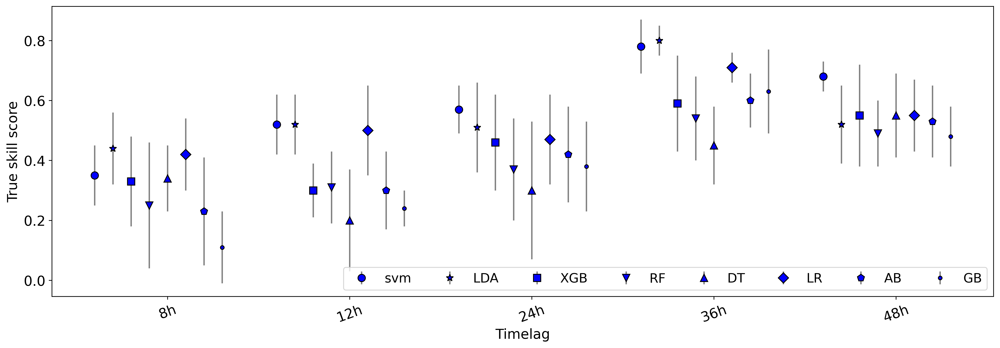

In [ ]:

##plot
import numpy as np
import matplotlib.pyplot as plt
Method=['svm','LDA','XGboost','RF','DT','LR','Adaboost','GB']
time_delay=['8h','12h','24h','36h','48h',]
x_pos_svm=np.arange(0,len(time_delay))
x_pos_lda=np.arange(0.1,len(time_delay)+0.1)
x_pos_xgboost=np.arange(0.2,len(time_delay)+0.2)
x_pos_RF=np.arange(0.3,len(time_delay)+0.3)
x_pos_DT=np.arange(0.4,len(time_delay)+0.4)
x_pos_LR=np.arange(0.5,len(time_delay)+0.5)
x_pos_ab=np.arange(0.6,len(time_delay)+0.6)
x_pos_gb=np.arange(0.7,len(time_delay)+0.7)
y_pos=np.arange(0,1,0.2)
fig,ax1 = plt.subplots(1,1,figsize=(15,5),dpi=200,sharey=True)
fig.tight_layout()
#ax1.bar(x_pos, mean_wo, yerr=std_wo, align='center', alpha=0.5, ecolor='black', capsize=10)
ax1.errorbar(x_pos_svm, sm_svm_m, yerr=sm_svm_std,marker='o', markersize=8,markeredgecolor='black',ecolor='gray',
            linestyle='none',color='blue',label='svm')
ax1.errorbar(x_pos_lda, sm_lda_m, yerr=sm_lda_std,marker='*', markersize=8,markeredgecolor='black',ecolor='gray',
            linestyle='none',color='blue',label='LDA')
ax1.errorbar(x_pos_xgboost, sm_xg_m, yerr=sm_xg_std,marker='s', markersize=8,markeredgecolor='black',ecolor='gray',
            linestyle='none',color='blue',label='XGB')
ax1.errorbar(x_pos_RF, sm_rf_m, yerr=sm_rf_std,marker='v', markersize=8,markeredgecolor='black',ecolor='gray',
            linestyle='none',color='blue',label='RF')
ax1.errorbar(x_pos_DT, sm_dt_m, yerr=sm_dt_std,marker='^', markersize=8,markeredgecolor='black',ecolor='gray',
            linestyle='none',color='blue',label='DT')
ax1.errorbar(x_pos_LR, sm_lr_m, yerr=sm_lr_std,marker='D', markersize=8,markeredgecolor='black',ecolor='gray',
            linestyle='none',color='blue',label='LR')
ax1.errorbar(x_pos_ab, sm_ab_m, yerr=sm_ab_std,marker='p', markersize=8,markeredgecolor='black',ecolor='gray',
            linestyle='none',color='blue',label='AB')
ax1.errorbar(x_pos_gb, sm_gb_m, yerr=sm_gb_std,marker='.', markersize=8,markeredgecolor='black',ecolor='gray',
            linestyle='none',color='blue',label='GB')

ax1.set_ylabel('True skill score',fontsize=15)
ax1.tick_params(axis='both',labelsize=15)
ax1.set_xticks(x_pos_DT)
ax1.set_xticklabels(time_delay,rotation=20,fontsize=15)
#ax1.set_title('RUS',fontsize=14)
#ax1.yaxis.grid(True)
#ax2.bar(x_pos, mean_rus, yerr=std_rus, align='center', alpha=0.5, ecolor='black', capsize=10)
ax1.set_xlabel('Timelag',fontsize=15)
#ax3.legend(bbox_to_anchor=(1.05, 1.0),loc='upper left',fontsize=14,ncol=len(Method))
plt.legend(fontsize=14,loc='lower right',ncol=len(Method))

# Save the figure and show

plt.show()

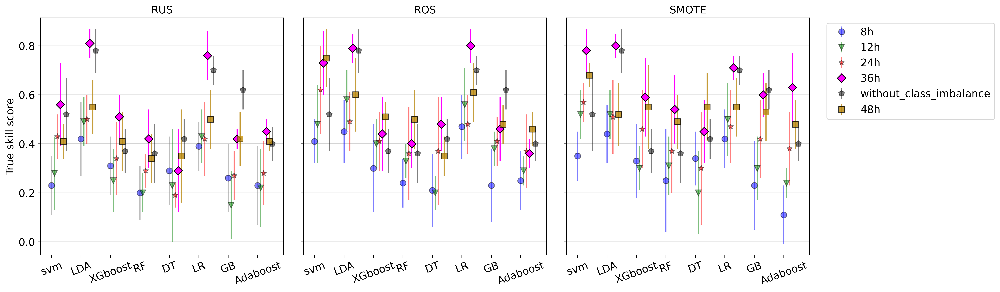

In [ ]:
##plot
import numpy as np
import matplotlib.pyplot as plt
Method=['svm','LDA','XGboost','RF','DT','LR','GB','Adaboost']
x_pos_8 = np.arange(0,len(Method))
x_pos_12=np.arange(0.1,len(Method)+0.1)
x_pos_24=np.arange(0.2,len(Method)+0.2)
x_pos_36=np.arange(0.3,len(Method)+0.3)
x_pos_wc=np.arange(0.5,len(Method)+0.5)
x_pos_48=np.arange(0.4,len(Method)+0.4)

# Build the plot
#fig = plt.figure()

fig,(ax1, ax2,ax3) = plt.subplots(1,3,figsize=(15,5),dpi=200,sharey=True)
fig.tight_layout()
#ax1.bar(x_pos, mean_wo, yerr=std_wo, align='center', alpha=0.5, ecolor='black', capsize=10)
ax1.errorbar(x_pos_8, rus_mean_8h, yerr=rus_std_8h,marker='o', markersize=8,markeredgecolor='black',ecolor='gray',
            linestyle='none',color='blue',alpha=0.5,label='8h')
ax1.errorbar(x_pos_12, rus_mean_12h, yerr=rus_std_12h,marker='v', markersize=8,markeredgecolor='black',
            linestyle='none',color='green',alpha=0.5,label='12h')
ax1.errorbar(x_pos_24, rus_mean_24h, yerr=rus_std_24h,marker='*', markersize=8,markeredgecolor='black',
            linestyle='none',color='red',alpha=0.5,label='24h')
ax1.errorbar(x_pos_36, rus_mean_36h, yerr=rus_std_36h,marker='D', markersize=8,markeredgecolor='black',
            linestyle='none',color='magenta',label='36h')
ax1.errorbar(x_pos_wc, wo_class_imbalance_36h_m, yerr=wo_class_imbalance_36h_std,marker='p', markersize=8,markeredgecolor='black',
            linestyle='none',color='black',alpha=0.5,label='wo_CI')
ax1.errorbar(x_pos_48, rus_mean_48h, yerr=rus_std_48h,marker='s', markersize=8,markeredgecolor='black',
            linestyle='none',color='darkgoldenrod',label='48h',alpha=0.8)
ax1.set_ylabel('True skill score',fontsize=14)
ax1.tick_params(axis='both',labelsize=14)
ax1.set_xticks(x_pos_8)
ax1.set_xticklabels(Method,rotation=20,fontsize=14)
ax1.set_title('RUS',fontsize=14)
ax1.yaxis.grid(True)
#ax2.bar(x_pos, mean_rus, yerr=std_rus, align='center', alpha=0.5, ecolor='black', capsize=10)

ax2.errorbar(x_pos_8, ros_mean_8h, yerr=ros_std_8h,marker='o', markersize=8,markeredgecolor='black',
            linestyle='none',color='blue',alpha=0.5,label='8h')
ax2.errorbar(x_pos_12, ros_mean_12h, yerr=ros_std_12h,marker='v', markersize=8,markeredgecolor='black',
            linestyle='none',color='green',alpha=0.5,label='12h')
ax2.errorbar(x_pos_24, ros_mean_24h, yerr=ros_std_24h,marker='*', markersize=8,markeredgecolor='black',
            linestyle='none',color='red',alpha=0.5,label='24h')
ax2.errorbar(x_pos_36, ros_mean_36h, yerr=ros_std_36h,marker='D', markersize=8,markeredgecolor='black',
            linestyle='none',color='magenta',label='36h')
ax2.errorbar(x_pos_wc, wo_class_imbalance_36h_m, yerr=wo_class_imbalance_36h_std,marker='p', markersize=8,markeredgecolor='black',
            linestyle='none',color='black',alpha=0.5,label='wo_CI')
ax2.errorbar(x_pos_48, ros_mean_48h, yerr=ros_std_48h,marker='s', markersize=8,markeredgecolor='black',
            linestyle='none',color='darkgoldenrod',alpha=0.8,label='48h')
ax2.tick_params(axis='both',labelsize=14)
ax2.set_xticks(x_pos_8)
ax2.set_xticklabels(Method,rotation=20,fontsize=14)
ax2.set_title('ROS',fontsize=14)
ax2.yaxis.grid(True)
#ax2.legend(bbox_to_anchor=(2, 1.05))

#ax3.bar(x_pos, mean_ros, yerr=std_ros, align='center', alpha=0.5, ecolor='black', capsize=10)
ax3.errorbar(x_pos_8, sm_mean_8h, yerr=sm_std_8h,marker='o', markersize=8,markeredgecolor='black',
            linestyle='none',color='blue',alpha=0.5,label='8h')
ax3.errorbar(x_pos_12, sm_mean_12h, yerr=sm_std_12h,marker='v', markersize=8,markeredgecolor='black',
            linestyle='none',color='green',alpha=0.5,label='12h')
ax3.errorbar(x_pos_24, sm_mean_24h, yerr=sm_std_24h,marker='*', markersize=8,markeredgecolor='black',
            linestyle='none',color='red',alpha=0.5,label='24h')
ax3.errorbar(x_pos_36, sm_mean_36h, yerr=sm_std_36h,marker='D', markersize=8,markeredgecolor='black',
            linestyle='none',color='magenta',label='36h')
ax3.errorbar(x_pos_wc, wo_class_imbalance_36h_m, yerr=wo_class_imbalance_36h_std,marker='p', markersize=8,markeredgecolor='black',
            linestyle='none',color='black',alpha=0.5,label='without_class_imbalance')
ax3.errorbar(x_pos_48, sm_mean_48h, yerr=sm_std_48h,marker='s', markersize=8,markeredgecolor='black',
            linestyle='none',color='darkgoldenrod',alpha=0.8,label='48h')
#ax3.set_ylabel('True skill score')
ax3.tick_params(axis='both',labelsize=14)
ax3.set_xticks(x_pos_8)
ax3.set_xticklabels(Method,rotation=20,fontsize=14)
ax3.set_title('SMOTE',fontsize=14)
ax3.yaxis.grid(True)
ax3.legend(bbox_to_anchor=(1.05, 1.0),loc='upper left',fontsize=14)

#plt.legend(fontsize=12)

# Save the figure and show

plt.show()

##wrapper

In [ ]:
    ##wrapper
    import joblib
    import sys
    sys.modules['sklearn.externals.joblib'] = joblib
    from mlxtend.feature_selection import SequentialFeatureSelector as SFS
    from sklearn.metrics import make_scorer
    from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs
    import matplotlib.pyplot as plt
    sampling=[without_sampling,RUS,ROS,SMOTE_test]
    def training_sampling_wrapper(positive_cl,negative_cl,kfolds,sampling):
      #svm1 = svm.SVC(C=4, gamma=0.075, kernel='rbf', class_weight={1: 6.5},
        #      cache_size=500, max_iter=-1, shrinking=True, tol=1e-8, probability=True)

      clf = SVC(C=4.0, gamma=0.0088,probability=True, kernel='rbf',class_weight={1:6.5}, cache_size=500, max_iter=-1, shrinking=True, tol=1e-8,probability=True)
      from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
      LDA = LinearDiscriminantAnalysis()
      these_TSS_for_this_k=[]
      method=[svm1,LDA]
      method1=['svm1','LDA']
      svm_per=[]
      LDA_per=[]
      method_per=[LDA_per,svm_per]
      CME_data,no_CME_data,xdata,ydata=data_gen_change(positive_cl,negative_cl)   ##change according to with/without change information

      skf = StratifiedKFold(n_splits=kfolds, shuffle=True)
      fold=0
      for train_index, test_index in skf.split(xdata, ydata):
          # xtrain are the examples in the training set
          xtrain2 = xdata[train_index]
          # ytrain are the labels in the training set
          ytrain2 = ydata[train_index]
          # xtest are the examples in the testing set
          xtest = xdata[test_index]
          ytest = ydata[test_index]    # ytest are the labels in the testing set

          #sampling training dataset
          xtrain1,ytrain1=sampling(xtrain2,ytrain2)
          #xtrain1=pd.DataFrame(xtrain1,columns=col)
          #xtest=pd.DataFrame(xtest,columns=col)
          fold+=1
          for i in range(0,2):
            print("#wrapper explanations for Foldnumber=",fold,"method=",method1[i])
            method[i].fit(xtrain1, ytrain1)
            y_pred=method[i].predict(xtest)
            sfs36= SFS(method[i], k_features=(3,17),forward=True, floating=True, verbose=2,cv=0,scoring=tss_scorer)
            sfs36.fit(xtrain1, ytrain1,custom_feature_names=col)
            #sfs36.k_feature_names_
            sfs36.subsets_
            method_per[i].append(np.array(pd.DataFrame.from_dict(sfs36.get_metric_dict()).T ))
      return method_per









In [ ]:
    ##wrapper with inbuilt wrapper kfold
    import joblib
    import sys
    sys.modules['sklearn.externals.joblib'] = joblib
    from mlxtend.feature_selection import SequentialFeatureSelector as SFS
    from sklearn.metrics import make_scorer
    from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs
    import matplotlib.pyplot as plt
    sampling=[without_sampling,RUS,ROS,SMOTE_test]
    def training_sampling_wrapper(positive_cl,negative_cl,n):
      svm1 = svm.SVC(C=4, gamma=0.075, kernel='rbf', class_weight={1: 6.5}, cache_size=500, max_iter=-1, shrinking=True, tol=1e-8, probability=True)
      clf = SVC(C=4.0, gamma=0.0088,probability=True, kernel='rbf',class_weight={1:6.5}, cache_size=500, max_iter=-1, shrinking=True, tol=1e-8)
      from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
      LDA = LinearDiscriminantAnalysis()
      if n==0:
        CME_data,no_CME_data,xdata,ydata=data_gen(positive_cl,negative_cl)   ##change according to with/without change information
        method=[LDA,svm1]
        k_features=(3,18)
        custom_feature_names=col
      else:
        CME_data,no_CME_data,xdata,ydata=data_gen_change(positive_cl,negative_cl)
        method=[LDA,clf]
        k_features=(3,30)
        custom_feature_names=col1
      these_TSS_for_this_k=[]
      method1=['LDA','svm1']
      svm_per=[]
      LDA_per=[]
      method_per=[LDA_per,svm_per]
      xtrain1, ytrain1=SMOTE_test(xdata,ydata)
      for i in range(0,2):
        print("#wrapper explanations for" ,"method=",method1[i])
        #method[i].fit(xtrain1, ytrain1)
        #y_pred=method[i].predict(xtest)
        sfs36= SFS(method[i], k_features=k_features,forward=True, floating=True, verbose=2,cv=4,scoring=tss_scorer)
        sfs36.fit(xtrain1, ytrain1,custom_feature_names=custom_feature_names)
            #sfs36.k_feature_names_
        sfs36.subsets_
        method_per[i].append(np.array(pd.DataFrame.from_dict(sfs36.get_metric_dict()).T ))
      return method_per



In [ ]:
svm1 = svm.SVC(C=4, gamma=0.075, kernel='rbf', class_weight={1: 6.5}, cache_size=500, max_iter=-1, shrinking=True, tol=1e-8, probability=True)

In [ ]:
#method_per=training_sampling_wrapper(positive_class_36,negative_class_36,0)
method_per=training_sampling_wrapper(data_p24_new,data_n24_new,1)

#wrapper explanations for method= LDA


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  36 out of  36 | elapsed:    0.4s finished

[2023-01-06 02:30:02] Features: 1/30 -- score: 0.08680555555555554[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  35 out of  35 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished

[2023-01-06 02:30:02] Features: 2/30 -- score: 0.41666666666666663[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_

#wrapper explanations for method= svm1


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  36 out of  36 | elapsed:  4.9min finished

[2023-01-06 02:35:28] Features: 1/30 -- score: 0.0[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  35 out of  35 | elapsed:  4.3min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   12.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   12.9s finished

[2023-01-06 02:40:01] Features: 2/30 -- score: 0.0[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  34 out of  34 | elapsed:  1.3min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend w

In [ ]:
score_lda=[]
score_svm=[]
for i in range(0,30):
  score_lda.append(np.array(method_per[0])[:,i,1])
  score_svm.append(np.array(method_per[1])[:,i,1])


In [ ]:
#score_lda=np.array(score_lda).reshape(4,15)
#score_svm=np.array(score_svm).reshape(4,15)
mean_lda_score=[]
std_lda_score=[]
mean_svm_score=[]
std_svm_score=[]
for i in range(0,30):
  mean_lda_score.append(np.mean(np.mean(np.array(score_lda[i]))))##mean into mean is working, only mean returns an entire array
  std_lda_score.append(np.std(np.mean(np.array(score_lda[i]))))
  mean_svm_score.append(np.mean(np.mean(np.array(score_svm[i]))))
  std_svm_score.append(np.std(np.mean(np.array(score_svm[i]))))

In [ ]:
std_svm_score

[0.0,
 0.0,
 0.0,
 0.006014065304058581,
 0.05810139073153307,
 0.0763888888888889,
 0.07670389595268932,
 0.07630993394387468,
 0.06468033336874014,
 0.04910463758239914,
 0.03850880731392154,
 0.04658474953124562,
 0.043228818048571954,
 0.04645516722312379,
 0.05242940580049132,
 0.03608439182435158,
 0.04108388738263621,
 0.04108388738263621,
 0.04861111111111112,
 0.04861111111111112,
 0.034548174899535426,
 0.04645516722312382,
 0.03850880731392159,
 0.04910463758239914,
 0.04910463758239914,
 0.04280843057617347,
 0.048486944596419945,
 0.042098457128410184,
 0.055880128261913485,
 0.054680610236193146]

In [ ]:
mean_svm_score

[0.0,
 0.0,
 0.0,
 0.00347222222222221,
 0.12500000000000003,
 0.6597222222222223,
 0.7083333333333335,
 0.7395833333333333,
 0.7604166666666667,
 0.7916666666666666,
 0.8229166666666667,
 0.8263888888888888,
 0.8506944444444444,
 0.8576388888888888,
 0.8680555555555556,
 0.8819444444444445,
 0.9097222222222222,
 0.9097222222222222,
 0.9097222222222222,
 0.9097222222222222,
 0.9131944444444444,
 0.90625,
 0.90625,
 0.9166666666666666,
 0.9166666666666666,
 0.9166666666666666,
 0.920138888888889,
 0.9201388888888888,
 0.90625,
 0.9027777777777778]

In [ ]:
std_lda_score

[0.07438987946398802,
 0.06588078458684123,
 0.08913540036800999,
 0.06759695254837426,
 0.06093725269022308,
 0.0655137578615042,
 0.03608439182435163,
 0.022768883764937464,
 0.03163344992758442,
 0.029462782549439494,
 0.02479662648799603,
 0.02479662648799603,
 0.02479662648799603,
 0.02479662648799603,
 0.020833333333333336,
 0.02503855052405547,
 0.02503855052405547,
 0.02503855052405547,
 0.03007032652029302,
 0.018042195912175832,
 0.02303211659969029,
 0.020541943691318114,
 0.02503855052405547,
 0.020541943691318114,
 0.026670644957877104,
 0.029462782549439494,
 0.0318234423260822,
 0.020541943691318117,
 0.020541943691318117,
 0.028632677955678205]

In [ ]:
mean_lda_score

[0.08680555555555554,
 0.41666666666666663,
 0.5173611111111112,
 0.65625,
 0.7291666666666666,
 0.8124999999999999,
 0.8541666666666666,
 0.8854166666666666,
 0.920138888888889,
 0.9444444444444445,
 0.9479166666666667,
 0.9479166666666667,
 0.9479166666666667,
 0.9479166666666667,
 0.9513888888888891,
 0.9513888888888891,
 0.9513888888888891,
 0.9513888888888891,
 0.9479166666666667,
 0.9479166666666667,
 0.9513888888888888,
 0.9548611111111112,
 0.951388888888889,
 0.9548611111111112,
 0.9479166666666667,
 0.9444444444444445,
 0.9652777777777778,
 0.96875,
 0.96875,
 0.9652777777777779]

In [ ]:
std_lda_score

In [ ]:
##without temporal information
mean_lda_score=[0.0912201514269074,
 0.2936323044069113,
 0.30608134342846044,
 0.4146767617938264,
 0.4766550184430208,
 0.5381721995728985,
 0.8245971655989128,
 0.8418510968743933,
 0.8666278392545137,
 0.8740293146961755,
 0.8715783343040187,
 0.8740293146961755,
 0.871554067171423,
 0.8690545525140749,
 0.8764560279557367,
 0.8715298000388274,
 0.8567025820229082,
 0.846753057658707]
std_lda_score=[0.0244797880024293,
 0.0954610886665624,
 0.0915574793313278,
 0.04579202133713876,
 0.06848518461929322,
 0.026469858075524714,
 0.05489485008831194,
 0.03712483468579012,
 0.021356951789334905,
 0.024397280102894638,
 0.018277388238893202,
 0.021283299074619077,
 0.01836871263510514,
 0.03297595278839951,
 0.033090075077829836,
 0.028741998402712153,
 0.02907055622554288,
 0.026574393875448812]
mean_svm_score=[0.014827218015919241,
 0.037031644340904696,
 0.09876722966414289,
 0.12592215103863327,
 0.19253543001358958,
 0.4321490972626675,
 0.7383760434867015,
 0.7975393127548049,
 0.925912444185595,
 0.9531158998252767,
 0.975393127548049,
 0.9778683750728014,
 0.9778198408076102,
 0.9827218015919239,
 0.9828188701223064,
 0.9803193554649583,
 0.9777955736750146,
 0.9654436031838478]
std_svm_score=[0.01108057044996327,
 0.017664005643344527,
 0.032085627935176685,
 0.028308200462287457,
 0.040809756291395924,
 0.049372064234121285,
 0.0681886692413464,
 0.049110843042929064,
 0.008677018587045377,
 0.018919401130787182,
 0.014673811564126294,
 0.016046429262061946,
 0.004175357447874806,
 0.010733866004099481,
 0.024379665306873733,
 0.01832865857434576,
 0.014557913319667,
 0.01633176220776401]

In [ ]:
x=np.arange(0,18,1)
plt.figure(figsize=(12,5),dpi=200)

#alpha = [np.float(1.0) if (i < 10) else np.float(0.5) for i in range(0,18) ]
plt.errorbar(x, np.array(mean_lda_score), yerr=np.array(std_lda_score), label='LDA',marker='o',markeredgecolor='black',linestyle='none',alpha=1)
plt.errorbar(x, np.array(mean_svm_score), yerr=np.array(std_svm_score), label='SVM',marker='s',markeredgecolor='black',linestyle='none',alpha=1)
plt.xticks(x,fontsize=12)
plt.yticks(fontsize=12)
plt.ylim(0,1)
plt.xlabel('Number of features',fontsize=14)
plt.ylabel('TSS score',fontsize=14)
plt.legend(fontsize=14,loc='best')

In [ ]:
##with temporal information
mean_lda_score=[0.08680555555555554,
 0.41666666666666663,
 0.5173611111111112,
 0.65625,
 0.7291666666666666,
 0.8124999999999999,
 0.8541666666666666,
 0.8854166666666666,
 0.920138888888889,
 0.9444444444444445,
 0.9479166666666667,
 0.9479166666666667,
 0.9479166666666667,
 0.9479166666666667,
 0.9513888888888891,
 0.9513888888888891,
 0.9513888888888891,
 0.9513888888888891,
 0.9479166666666667,
 0.9479166666666667,
 0.9513888888888888,
 0.9548611111111112,
 0.951388888888889,
 0.9548611111111112,
 0.9479166666666667,
 0.9444444444444445,
 0.9652777777777778,
 0.96875,
 0.96875,
 0.9652777777777779]
std_lda_score=[0.07438987946398802,
 0.06588078458684123,
 0.08913540036800999,
 0.06759695254837426,
 0.06093725269022308,
 0.0655137578615042,
 0.03608439182435163,
 0.022768883764937464,
 0.03163344992758442,
 0.029462782549439494,
 0.02479662648799603,
 0.02479662648799603,
 0.02479662648799603,
 0.02479662648799603,
 0.020833333333333336,
 0.02503855052405547,
 0.02503855052405547,
 0.02503855052405547,
 0.03007032652029302,
 0.018042195912175832,
 0.02303211659969029,
 0.020541943691318114,
 0.02503855052405547,
 0.020541943691318114,
 0.026670644957877104,
 0.029462782549439494,
 0.0318234423260822,
 0.020541943691318117,
 0.020541943691318117,
 0.028632677955678205]
mean_svm_score=[0.0,
 0.0,
 0.0,
 0.00347222222222221,
 0.12500000000000003,
 0.6597222222222223,
 0.7083333333333335,
 0.7395833333333333,
 0.7604166666666667,
 0.7916666666666666,
 0.8229166666666667,
 0.8263888888888888,
 0.8506944444444444,
 0.8576388888888888,
 0.8680555555555556,
 0.8819444444444445,
 0.9097222222222222,
 0.9097222222222222,
 0.9097222222222222,
 0.9097222222222222,
 0.9131944444444444,
 0.90625,
 0.90625,
 0.9166666666666666,
 0.9166666666666666,
 0.9166666666666666,
 0.920138888888889,
 0.9201388888888888,
 0.90625,
 0.9027777777777778]
std_svm_score=[0.0,
 0.0,
 0.0,
 0.006014065304058581,
 0.05810139073153307,
 0.0763888888888889,
 0.07670389595268932,
 0.07630993394387468,
 0.06468033336874014,
 0.04910463758239914,
 0.03850880731392154,
 0.04658474953124562,
 0.043228818048571954,
 0.04645516722312379,
 0.05242940580049132,
 0.03608439182435158,
 0.04108388738263621,
 0.04108388738263621,
 0.04861111111111112,
 0.04861111111111112,
 0.034548174899535426,
 0.04645516722312382,
 0.03850880731392159,
 0.04910463758239914,
 0.04910463758239914,
 0.04280843057617347,
 0.048486944596419945,
 0.042098457128410184,
 0.055880128261913485,
 0.054680610236193146]

In [ ]:
5

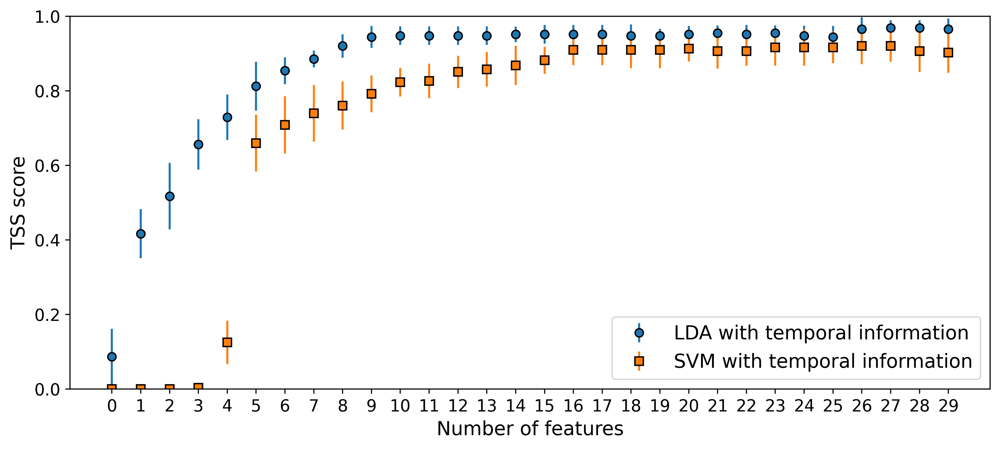

In [ ]:
x=np.arange(0,30,1)
plt.figure(figsize=(12,5),dpi=200)
plt.errorbar(x, np.array(mean_lda_score), yerr=np.array(std_lda_score), label='LDA with temporal information',marker='o',markeredgecolor='black',linestyle='none')
plt.errorbar(x, np.array(mean_svm_score), yerr=np.array(std_svm_score), label='SVM with temporal information',marker='s',markeredgecolor='black',linestyle='none')
plt.xticks(x,fontsize=12)
plt.yticks(fontsize=12)
plt.ylim(0,1)
plt.xlabel('Number of features',fontsize=14)
plt.ylabel('TSS score',fontsize=14)
plt.legend(fontsize=14,loc='best')

In [ ]:
np.array(method_per[1])[:,13,:]

In [ ]:
np.array(method_per[1])[,10,:]

##DALEX

In [ ]:
!pip install dalex

In [ ]:
    ##without change information
    ##explanation for model prediction
    import dalex as dx
    def explanation_models_default(positive_cl,negative_cl,kfolds,sampling):
      these_TSS_for_this_k=[]

      method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']
      CME_data,no_CME_data,xdata,ydata=data_gen(positive_cl,negative_cl)        ###change for change information
      skf = StratifiedKFold(n_splits=kfolds, shuffle=True)
      fold=0
      for train_index, test_index in skf.split(xdata, ydata):
          # xtrain are the examples in the training set
          xtrain2 = xdata[train_index]
          # ytrain are the labels in the training set
          ytrain2 = ydata[train_index]
          # xtest are the examples in the testing set
          xtest = xdata[test_index]
          ytest = ydata[test_index]    # ytest are the labels in the testing set

          #sampling training dataset
          xtrain1,ytrain1=sampling(xtrain2,ytrain2)
          xtrain1=pd.DataFrame(xtrain1,columns=col)###change for change information
          xtest=pd.DataFrame(xtest,columns=col)###change for change information
          fold+=1
          for i in range(0,2):
            svm1,LDA,XGboost,RF,DT,LR,GB,Adaboost= model_list_wo_hyper() ###change clf,svm for change information
            method=[svm1,LDA,XGboost,RF,DT,LR,GB,Adaboost]                ###change clf,svm for change information
            print("#model-level explanations for Foldnumber=",fold,"method=",method1[i])
            method[i].fit(xtrain1, ytrain1)
            y_pred=method[i].predict(xtest)
            TN, FP, TP, FN = confusion_table(y_pred, ytest)
            if (((TP+FN) == 0.0) or (FP+TN) == 0.0) or(FP+TP)==0.0:
                these_TSS_for_this_k.append(np.nan)
                continue
            else:
                these_TSS_for_this_k.append(TP/(TP+FN) - FP/(FP+TN))
            #TP0,FP0,TN0,FN0=index_table(y_pred,ytest)
            # custom (binary) predict function
            #pf_1 = lambda m, d: m.predict_proba(d)[:, 1]  #change class of prediction
            # custom (binary) target values
            #y_0 = ytrain1 == 1 #change class of prediction
            dx_exp = dx.Explainer(method[i],xtrain1,ytrain1, label = "prediction explanation, ")
            dx_exp.model_parts().plot()
            #dx_exp.predict_parts(xtest).plot() ##variable contribution to single prediction
            dx_exp.model_profile().plot()
            grouped = dx_exp.model_parts(
                variable_groups={'Magnetic free energy': ['MEANPOT', 'TOTPOT'],
                                 'Shear angle':['MEANSHR', 'SHRGT45'],
                                 'current Helicity':['MEANJZH','TOTUSJH','ABSNJZH'],
                                 'twist parameter':['MEANALP',],
                                 'Bfield gradient':['MEANGBH','MEANGBT','MEANGBZ'],
                                 'Distribution of Bfield':['USFLUX','AREA_ACR','R_VALUE'],
                                 'current density':['MEANJZD','TOTUSJZ','SAVNCPP']})  ##model_parts- variable contribution to model performance
            grouped.plot()
      return np.array(these_TSS_for_this_k).reshape(kfolds,2)

In [ ]:
col

['USFLUX',
 'MEANGBT',
 'MEANJZH',
 'MEANPOT',
 'SHRGT45',
 'TOTUSJH',
 'MEANGBH',
 'MEANALP',
 'MEANGAM',
 'MEANGBZ',
 'MEANJZD',
 'TOTUSJZ',
 'SAVNCPP',
 'TOTPOT',
 'MEANSHR',
 'AREA_ACR',
 'R_VALUE',
 'ABSNJZH']

In [ ]:
TSS_4_all=explanation_models_default(positive_class_36,negative_class_36,5,SMOTE_test)

#model-level explanations for Foldnumber= 1 method= svm1
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1.42e-06, mean = 0.494, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.706, mean = 0.00565, max = 0.889
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:11<00:00,  1.52it/s]


#model-level explanations for Foldnumber= 1 method= LDA
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.discriminant_analysis.LinearDiscriminantAnalysis (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 2.85e-09, mean = 0.514, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.967, mean = -0.0139, max = 0.992
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LinearDiscriminantAnalysis was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:00<00:00, 42.06it/s]


#model-level explanations for Foldnumber= 2 method= svm1
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1.49e-07, mean = 0.496, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.355, mean = 0.00382, max = 0.679
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:11<00:00,  1.53it/s]


#model-level explanations for Foldnumber= 2 method= LDA
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.discriminant_analysis.LinearDiscriminantAnalysis (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1.05e-09, mean = 0.518, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.986, mean = -0.0185, max = 0.99
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LinearDiscriminantAnalysis was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:00<00:00, 71.67it/s]


#model-level explanations for Foldnumber= 3 method= svm1
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1e-07, mean = 0.497, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.651, mean = 0.00314, max = 0.946
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:11<00:00,  1.51it/s]


#model-level explanations for Foldnumber= 3 method= LDA
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.discriminant_analysis.LinearDiscriminantAnalysis (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 3.16e-09, mean = 0.52, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.995, mean = -0.0202, max = 0.938
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LinearDiscriminantAnalysis was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:00<00:00, 65.42it/s]


#model-level explanations for Foldnumber= 4 method= svm1
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 2.94e-07, mean = 0.502, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.547, mean = -0.00154, max = 0.369
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:12<00:00,  1.41it/s]


#model-level explanations for Foldnumber= 4 method= LDA
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.discriminant_analysis.LinearDiscriminantAnalysis (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 1.04e-10, mean = 0.513, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.983, mean = -0.0133, max = 0.984
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LinearDiscriminantAnalysis was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:00<00:00, 54.00it/s]


#model-level explanations for Foldnumber= 5 method= svm1
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 3.63e-06, mean = 0.499, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.281, mean = 0.00113, max = 0.942
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVC was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:12<00:00,  1.49it/s]


#model-level explanations for Foldnumber= 5 method= LDA
Preparation of a new explainer is initiated

  -> data              : 648 rows 18 cols
  -> target variable   : 648 values
  -> model_class       : sklearn.discriminant_analysis.LinearDiscriminantAnalysis (default)
  -> label             : prediction explanation, 
  -> predict function  : <function yhat_proba_default at 0x7f1a9ace7170> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 3.11e-09, mean = 0.505, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.93, mean = -0.00528, max = 0.97
  -> model_info        : package sklearn

A new explainer has been created!


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LinearDiscriminantAnalysis was fitted with feature names



Calculating ceteris paribus: 100%|██████████| 18/18 [00:00<00:00, 61.83it/s]


In [ ]:
    ##without change information
    ##explanation for model prediction
    #import dalex as dx
    import shap
    def explanation_models_shap(positive_cl,negative_cl,kfolds,sampling):
      these_TSS_for_this_k=[]

      method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']
      CME_data,no_CME_data,xdata,ydata=data_gen(positive_cl,negative_cl)        ###change for change information
      skf = StratifiedKFold(n_splits=kfolds, shuffle=True)
      fold=0
      for train_index, test_index in skf.split(xdata, ydata):
          # xtrain are the examples in the training set
          xtrain2 = xdata[train_index]
          # ytrain are the labels in the training set
          ytrain2 = ydata[train_index]
          # xtest are the examples in the testing set
          xtest = xdata[test_index]
          ytest = ydata[test_index]    # ytest are the labels in the testing set

          #sampling training dataset
          xtrain1,ytrain1=sampling(xtrain2,ytrain2)
          xtrain1=pd.DataFrame(xtrain1,columns=col)###change for change information
          xtest=pd.DataFrame(xtest,columns=col)###change for change information
          fold+=1
          svm1,clf,LDA,XGboost,RF,DT,LR,GB,Adaboost= model_list_wo_hyper() ###change clf,svm for change information
          method=[svm1,LDA,XGboost,RF,DT,LR,GB,Adaboost]                ###change clf,svm for change information
          for i in range(0,2):
            print("#model-level explanations for Foldnumber=",fold,"method=",method[i])
            method[i].fit(xtrain1, ytrain1)
            y_pred=method[i].predict(xtest)
            TN, FP, TP, FN = confusion_table(y_pred, ytest)
            if (((TP+FN) == 0.0) or (FP+TN) == 0.0) or(FP+TP)==0.0:
                these_TSS_for_this_k.append(np.nan)
                continue
            else:
                these_TSS_for_this_k.append(TP/(TP+FN) - FP/(FP+TN))
            #TP0,FP0,TN0,FN0=index_table(y_pred,ytest)
            explainer = shap.Explainer(method[i], xtrain1)
            shap_values = explainer(xtrain1)
            clust = shap.utils.hclust(xtrain1, ytrain1, linkage="single")
            shap.plots.bar(shap_values, clustering=clust, clustering_cutoff=1)
            shap.plots.beeswarm(shap_values,max_display=17,color=plt.get_cmap("cool"))
            for name in xtrain1.columns:
              shap.dependence_plot(name, shap_values, xtrain1, display_features=xtrain1)
      return np.array(these_TSS_for_this_k).reshape(kfolds,2)

In [ ]:
explainer=shap.KernelExplainer(svm1.predict,xtrain1,keep_index=True)
print(explainer.shap_values(xtrain1.iloc[0:3,:]))
#shap_values = explainer(xtrain1)
#shap.plots.bar(explainer, clustering=clust, clustering_cutoff=1)

  0%|          | 0/3 [00:00<?, ?it/s]

The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight

[[ 0.0536826  -0.10336462 -0.00488139 -0.30968749 -0.07769069 -0.00231279
   0.00896738 -0.0017803   0.3078015   0.01315882 -0.04847597 -0.00736135
  -0.02359925  0.07232671 -0.35736631 -0.02897481 -0.04315364  0.0511684 ]
 [-0.31572378  0.04564293  0.          0.01416781 -0.01425255  0.00525478
   0.0268711  -0.02816001  0.06074711 -0.11983096  0.          0.0195697
   0.03156956 -0.09780238 -0.15741098  0.07725118 -0.01179035 -0.03764638]
 [-0.23125738  0.01426086  0.04295186  0.04877934 -0.01353022  0.
   0.01139749 -0.01478636  0.06602903  0.01980708  0.01868782  0.00858697
   0.00446502 -0.08522268 -0.11173693  0.11215428  0.027147   -0.41927639]]


The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLarsIC())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 


In [ ]:
    ##explanation for model prediction for change information
    import dalex as dx
    def explanation_models(positive_cl,negative_cl,kfolds,sampling):
      these_TSS_for_this_k=[]

      method1=['svm1','LDA','XGboost','RF','DT','LR','GB','Adaboost']
      CME_data,no_CME_data,xdata,ydata=data_gen(positive_cl,negative_cl)        ###change for change information
      skf = StratifiedKFold(n_splits=kfolds, shuffle=True)
      fold=0
      for train_index, test_index in skf.split(xdata, ydata):
          # xtrain are the examples in the training set
          xtrain2 = xdata[train_index]
          # ytrain are the labels in the training set
          ytrain2 = ydata[train_index]
          # xtest are the examples in the testing set
          xtest = xdata[test_index]
          ytest = ydata[test_index]    # ytest are the labels in the testing set

          #sampling training dataset
          xtrain1,ytrain1=sampling(xtrain2,ytrain2)
          xtrain1=pd.DataFrame(xtrain1,columns=col)###change for change information
          xtest=pd.DataFrame(xtest,columns=col)###change for change information
          fold+=1
          for i in range(0,2):
            svm1,LDA,XGboost,RF,DT,LR,GB,Adaboost= model_list_wo_hyper() ###change clf,svm for change information
            method=[svm1,LDA,XGboost,RF,DT,LR,GB,Adaboost]                ###change clf,svm for change information
            print("#model-level explanations for Foldnumber=",fold,"method=",method1[i])
            method[i].fit(xtrain1, ytrain1)
            y_pred=method[i].predict(xtest)
            TN, FP, TP, FN = confusion_table(y_pred, ytest)
            if (((TP+FN) == 0.0) or (FP+TN) == 0.0) or(FP+TP)==0.0:
                these_TSS_for_this_k.append(np.nan)
                continue
            else:
                these_TSS_for_this_k.append(TP/(TP+FN) - FP/(FP+TN))
            #TP0,FP0,TN0,FN0=index_table(y_pred,ytest)
            # custom (binary) predict function
            #pf_1 = lambda m, d: m.predict_proba(d)[:, 1]  #change class of prediction
            # custom (binary) target values
            #y_0 = ytrain1 == 1 #change class of prediction
            dx_exp = dx.Explainer(method[i],xtrain1,ytrain1, label = "prediction explanation, ")
            dx_exp.model_parts().plot()
            #dx_exp.predict_parts(xtest).plot() ##variable contribution to single prediction
            dx_exp.model_profile().plot()
            grouped = dx_exp.model_parts(
                variable_groups={'Magnetic free energy': ['MEANPOT,', 'TOTPOT,','diff_MEANPOT,','diff_TOTPOT,'],
                                 'Shear angle':['MEANSHR,', 'SHRGT45,','diff_SHRGT45,','diff_MEANSHR,'],
                                 'current Helicity':['MEANJZH,','TOTUSJH,','ABSNJZH','diff_TOTUSJH,','diff_MEANJZH,','diff_ABSNJZH'],
                                 'twist parameter':['MEANALP,','diff_MEANALP,'],
                                 'Bfield gradient':['MEANGBH,','MEANGBT,','MEANGBZ,','diff_MEANGBH,','diff_MEANGBT,','diff_MEANGBZ,'],
                                 'Distribution of Bfield':['USFLUX,','AREA_ACR,','R_VALUE,','diff_USFLUX,','diff_AREA_ACR,','diff_R_VALUE,'],
                                 'current density':['MEANJZD,','TOTUSJZ,','SAVNCPP,','diff_MEANJZD,','diff_TOTUSJZ,','diff_SAVNCPP,']})  ##model_parts- variable contribution to model performance
            grouped.plot()
      return np.array(these_TSS_for_this_k).reshape(kfolds,2)
          #return CME_model_results

In [ ]:
col

['USFLUX',
 'MEANGBT',
 'MEANJZH',
 'MEANPOT',
 'SHRGT45',
 'TOTUSJH',
 'MEANGBH',
 'MEANALP',
 'MEANGAM',
 'MEANGBZ',
 'MEANJZD',
 'TOTUSJZ',
 'SAVNCPP',
 'TOTPOT',
 'MEANSHR',
 'AREA_ACR',
 'R_VALUE',
 'ABSNJZH']

In [ ]:
#Best TSS  and worst TSS for nth fold for SVM and LDA to pick the concerned dalex model explanations
print("Best tss fold_svm:",np.argmax(TSS_6_all[:,0]))
print("worst tss fold_svm:",np.argmin(TSS_6_all[:,0]))
print("Best tss fold_lda:",np.argmax(TSS_6_all[:,1]))
print("worst tss fold_lda:",np.argmin(TSS_6_all[:,1]))

#wrost TSS for SVM

Best tss fold_svm: 4
worst tss fold_svm: 3
Best tss fold_lda: 0
worst tss fold_lda: 3


In [ ]:
np.array(TSS_k).reshape(6,8)

array([[0.54201681, 0.69747899, 0.58403361, 0.47058824, 0.46848739,
        0.6092437 , 0.56932773, 0.46428571],
       [0.7710084 , 0.79831933, 0.58403361, 0.42647059, 0.63865546,
        0.79831933, 0.56932773, 0.79831933],
       [0.82773109, 0.72689076, 0.56932773, 0.54201681, 0.53991597,
        0.69747899, 0.55462185, 0.48109244],
       [0.85870647, 0.82885572, 0.67363184, 0.74029851, 0.39900498,
        0.79900498, 0.75522388, 0.67263682],
       [0.85714286, 0.88379531, 0.68443497, 0.31236674, 0.6663113 ,
        0.79744136, 0.75586354, 0.7228145 ],
       [0.78571429, 0.69616205, 0.48187633, 0.6130064 , 0.42217484,
        0.68123667, 0.44029851, 0.63646055]])